# Projet 6: Classifiez automatiquement des biens de consommation 

    * L’entreprise "Place de marché” souhaite lancer une marketplace e-commerce. Sur la "Place de marché", des vendeurs proposent des articles à des acheteurs en postant une photo et une description.

    Pour l'instant, l'attribution de la catégorie d'un article est effectuée manuellement par les vendeurs, et est donc peu fiable. De plus, le volume des articles est pour l’instant très petit.

    Pour rendre l’expérience utilisateur des vendeurs (faciliter la mise en ligne de nouveaux articles) et des acheteurs (faciliter la recherche de produits) la plus fluide possible, et dans l'optique d'un passage à l'échelle, il devient nécessaire d'automatiser cette tâche.

       Ainsi, l'objectif de ce projet sera d'étudier la faisabilité d'un moteur de classification des articles en différentes catégories, avec un niveau de précision suffisant.

       Durant le projet, nous procéderons à la réalisation d'une première étude de faisabilité d'un moteur de classification d'articles, basé sur une image et une description, pour l'automatisation de l'attribution de la catégorie de l'article.

    Le jeu de données sera analysé en réalisant un prétraitement des descriptions des produits et des images, une réduction de dimension, puis un 'clustering'. Les résultats de la réduction de dimension et du clustering seront à présenter sous la forme de graphiques en deux dimensions, et confirmés par un calcul de similitude entre les catégories réelles et les clusters (groupes ou classes). Ces résultats illustreront le fait que les caractéristiques extraites permettent de regrouper des produits de même catégorie.

    Afin d’extraire les features texte, il sera nécessaire de mettre en œuvre: 
        1.Deux approches de type “bag-of-words”, comptage simple de mots et Tf-idf;
        2.Une approche de type word/sentence embedding classique avec Word2Vec (ou Glove ou FastText);
        3.Une approche de type word/sentence embedding avec BERT;
        4.une approche de type word/sentence embedding avec USE (Universal Sentence Encoder). 

        Afin d’extraire les features image, il sera nécessaire de mettre en œuvre:
        1.Un algorithme de type SIFT/ORB/SURF;
        2.Un algorithme de type CNN Transfer Learning.

    Remarque:

        Il est important de noté que l'objéctif du projet est d'effectuer une étude de faisabilitéer et non de fournir un moteur de classification supervisée. 

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
pd.options.mode.chained_assignment = None  # default='warn'

# Encodage
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder

# Normalization
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, QuantileTransformer

# Imputation
from sklearn.impute import SimpleImputer

# Featurs selection

# Création de pipelines
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import make_column_transformer, ColumnTransformer, make_column_selector

# Séparateur de jeu de données
from sklearn.model_selection import train_test_split 

# Models
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
#from xgboost import XGBRegressor
import os
from P6_Img_Funt import *

import cv2
import PIL as PIL
from PIL import Image, ImageOps, ImageFilter

from PIL.ImageFilter import GaussianBlur

from IPython.display import Image as ShowImage

from scipy import signal
from matplotlib.pyplot import imshow, get_cmap # pour la convolution

from sklearn.decomposition import PCA
#from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [2]:
#************************************ Valeurs manquantes et pourcentage en tableau % **************************************

def mssng_val(df):
    mssng_t = pd.DataFrame(columns=['Variable_name', 'Missing_values', 'Missing_rate'])
    mssng_t['Variable_name'] = df.columns
    
    missing = list()
    percentage_missing = list()
    
    for col in df.columns:
        nb_missing = df[col].isna().sum()                  # le nombre des valeurs NaN par colonne
        pc_missing = df[col].isna().sum()/df[col].size     # le pourcentage des valeurs NaN par colonne
        
        missing.append(nb_missing)
        percentage_missing.append(pc_missing)
        
    mssng_t['Missing_values'] = list(missing)
    mssng_t['Missing_rate'] = list(percentage_missing)
    mssng_t = mssng_t.sort_values(by= ['Missing_values'], ascending = False)
    return mssng_t

In [3]:
def get_files(path_list):
    '''Renvoie la liste des matrices d\'images à partir d'une liste de chemins'''
    liste_image = []
    compteur = 0
    for image_path in path_list:
        #im = cv2.imread(image_path, 0)
        im = np.array(Image.open(image_path))
        liste_image.append(im)
        compteur +=1
    
    del compteur
    del im
    
    return liste_image

def redim(array_im, width, height):
    '''Redimensionne l\'image correspondant à array_im dans la largeur et la hauteur définie'''
    min_x = 100000
    max_x = 0
    min_y = 100000
    max_y = 0
    shape = array_im.shape
    if shape[0] < min_x:
        min_x = shape[0]
    elif shape[0] > max_x:
        max_x = shape[0]
    if shape[1] < min_y:
        min_y = shape[1]
    elif shape[1] > max_y:
        max_y = shape[1]
    im = cv2.resize(array_im, dsize=(width,height))
    
    del shape
    
    return im

In [4]:

def display_two_images(img1, img2):
    _,axes = plt.subplots(ncols=2)
    axes[0].imshow(img1, cmap= plt.get_cmap('gray'))
    axes[1].imshow(img2, cmap= plt.get_cmap('gray'))

# 1. Resize Image

def resize_to_Square(img, size, interpolation=Image.ANTIALIAS):

    # can be PIL.Image.Image or np.array
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    elif type(img) == PIL.Image.Image:
        pass
    else:
        print("ERROR: image format unknown, please give np.array or PIL.Image.Image")
    # PIL.Image.Image format from here

    w, h = img.size
    if h != w:
        dif = h if h > w else w
        new_img = Image.new('RGB', (dif, dif), (255,255,255))
        new_img.paste(img, (int((dif - w) / 2), int((dif - h) / 2)))
        img = new_img

    # Change format to np.array and resize with cv2
    new_img = cv2.resize(np.asarray(img), (size, size), interpolation)
    return np.array(new_img)


# 2. RGB to Grey

def rgb_to_grey(img):

    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2GRAY)


# 3. Gaussian Blur

def gauss_blur(img, k):
     # can be PIL.Image.Image or np.array
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    elif type(img) == PIL.Image.Image:
        pass
    else:
        print("ERROR: image format unknown, please give np.array or PIL.Image.Image")
    # PIL.Image.Image format from here

    img_ = cv2.GaussianBlur(img, (k, k),0)
    return display_two_images(img,img_)


# 4. Filtrage Par Convolution

def conv_img(img,karnel_size):
    image = img.copy()
    kernel = np.ones((karnel_size,karnel_size), np.float32)/2
    img_convol = signal.convolve2d(image,
                              kernel,
                              mode='same',
                              boundary='fill',
                              fillvalue=0)
    return display_two_images(image, img_convol)


# 5. Filtre Moyenneur

def filtre_moyenneur(img, voisinage = 1):
    '''Remplace chaque pixel par l\'intensité moyenne de son voisinage'''
    etendue = 1+2*voisinage
    img_ = np.copy(img)

    for i in range(0, img.shape[0]):
        for j in range(0, img.shape[1]):
            if (i<voisinage)|(i>img.shape[0] - voisinage-1):
                img_[i,j] = int(255/2)
            if (j<voisinage)|(j>img.shape[0] - voisinage-1):
                img_[i,j] = int(255/2)

    for i in range(voisinage,img.shape[0]-voisinage):
        for j in range(voisinage,img.shape[1]-voisinage):
            mean = 0
            for mean_x in range(i-voisinage, i+voisinage+1):
                for mean_y in range(j-voisinage, j+voisinage+1):
                    mean += img[mean_x, mean_y]
            img_[i,j] = mean/(etendue**2)             # la moyenne diviser sur 9 (3**2)

    return display_two_images(img,img_)


# 6.auto_contrst

def auto_contrst(img):
    return ImageOps.autocontrast(Image.fromarray(img))


# 7.equalize_hist

def equalize_hist(img):
    return ImageOps.equalize(img)


# 8.GaussianBlur

def gaussianBlur(img, k):

    return img.filter(ImageFilter.GaussianBlur(radius=k))

# PCA
def PCA_features_reduction(X_std, var_threshold=0.9, verbose=True):
    """Return the principal components from PCA, until variance threshold."""

    from sklearn import decomposition
    
    if verbose == True:
        print("Initial number of features:", X_std.shape[1])
    
    # Processing the PCA
    pca = decomposition.PCA()
    SS = StandardScaler()
    pca.fit(SS.fit_transform(np.transpose(X_std.T)))
    
    
    # Getting the explained variance ratio for each principal component
    scree = pca.explained_variance_ratio_

    # Getting the number of principal components to reach variance thresholds
    mask = scree.cumsum() > var_threshold
    nb_selected_features = len(scree[~mask]) + 1
    if verbose == True:
        print("Number of selected features:", nb_selected_features)
    
    # Compute and displays the actual ratio of explained variance
    explained_variance_sum = scree.cumsum()[nb_selected_features-1]
    if verbose == True:
        print("Cumulative explained variance:  {:.2f}%".format(explained_variance_sum*100))
    
    # Getting the projection of the data on the first components
    X_projected = pca.transform(X_std)[:,:nb_selected_features]
    
    return X_projected, pca

In [5]:
#********************************** Calcule des valeurs nulles + pourcentage: ******************************
def calc_inf (df,line):
    
    # ****************** Définition des variabes************************************************************
    nb_line_nan = nb_line_mix = nb_line_ssna= nb_col_nan = nb_col_mix = nb_col_ssna = 0   
         
    #***************************************************** Les statistiques NaN par colonne*****************
    
    n_list = df.isnull().sum().tolist()
    for i in range(len(n_list)):
        if n_list[i] == 0:                     # Nombre de colonnes sans NaN
            nb_col_ssna += 1  
        elif n_list[i] == len(df):             # Nombre de colonnes nulles
            nb_col_nan += 1
        elif 0 < n_list[i] < len(df):          # Nombre de colonnes mixtes
            nb_col_mix += 1
    print("* Nombre de colonnes sans NaN -------:",nb_col_ssna)
    print("* Nombre de colonnes NaN ------------:", nb_col_nan)
    print("* Nombre de colonnes mixtes----------:",nb_col_mix)
   # *************************************** Les statistiques NaN par ligne ********************************

    if line == True:
        for j in range(len(df.index)) :
            if df.iloc[j].isnull().sum() == len(df.columns):         # Nombre de lignes nulles
                nb_line_nan += 1
            elif 0 < df.iloc[j].isnull().sum() < len(df.columns):    # Nombre de lignes mixtes
                nb_line_mix += 1
            elif df.iloc[j].isnull().sum() == 0:                     # Nombre de lignes sans NaN
                nb_line_ssna += 1
        print("* Nombre de ligne entièrement nulles :",nb_line_nan)  
        print("* Nombre de ligne mixtes ----------- :", nb_line_mix) 
        print("* Nombre de ligne sans NaN ----------:", nb_line_ssna)
    #*******************************************************************************************************
    nb_line = df.index.size
    nb_colonne = df.columns.size
    tot = (nb_colonne*nb_line)
    nan = df.isnull().sum().sum()
    nan_prcnt = (100 * nan) / tot
    not_nan = df.notna().sum().sum()
    not_nan_prcnt = float((100 * not_nan) / tot)
    #*******************************************************************************************************
    
    print("* Nombre de lignes -----------------------: {:.0f}".format(nb_line))
    print("* Nombre de colonnes ---------------------: {:.0f}".format(nb_colonne))
    print("* Nombre de cases ------------------------: {:.0f}".format(tot))
    print("* Nombre de valeurs nulles ---------------: {:.0f}".format(nan))
    print("* Nombre de valeurs non nulles -----------: {:.0f}".format(not_nan))
    print("* le pourcentage des valeurs nulles ------:",str("%.1f" % nan_prcnt) + ' %')
    print("* le pourcentage des valeurs non nulles --:",str("%.1f" % not_nan_prcnt) + ' %')
    #a = pd.concat([not_nan_prcnt,nan_prcnt])
    # *******************************************************************************************************
    
    t= [not_nan_prcnt, nan_prcnt]
    plt.pie(t, labels = ['Valeurs non nulles', 
                         'Valeurs nulles (NaN)'],colors =['c', 'r'],
            startangle = 90, shadow = True, explode =(0,0.1),
            autopct = "%1.1f%%", normalize = True)
    plt.title("Le taux de remplissage en %")
    plt.show()

# 1. La récupération de données:
***

In [6]:
data = pd.read_csv('D:\\Projet Classrooms\\Projet_6\\flipkart_com-ecommerce_sample_1050.csv',sep=',')

In [7]:
data.shape

(1050, 15)

## 1.1 Visualisation et description de données

In [8]:
data.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

* Nombre de colonnes sans NaN -------: 11
* Nombre de colonnes NaN ------------: 0
* Nombre de colonnes mixtes----------: 4
* Nombre de ligne entièrement nulles : 0
* Nombre de ligne mixtes ----------- : 340
* Nombre de ligne sans NaN ----------: 710
* Nombre de lignes -----------------------: 1050
* Nombre de colonnes ---------------------: 15
* Nombre de cases ------------------------: 15750
* Nombre de valeurs nulles ---------------: 341
* Nombre de valeurs non nulles -----------: 15409
* le pourcentage des valeurs nulles ------: 2.2 %
* le pourcentage des valeurs non nulles --: 97.8 %


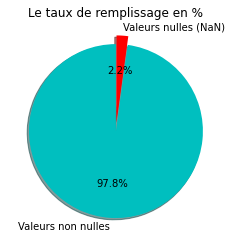

In [9]:
calc_inf(data, True)

In [10]:
data.isnull().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [11]:
mssng_val = mssng_val(data)
mssng_val

,Variable_name,Missing_values,Missing_rate
13,brand,338,0.321905
6,retail_price,1,0.000952
7,discounted_price,1,0.000952
14,product_specifications,1,0.000952
0,uniq_id,0,0.000000
1,crawl_timestamp,0,0.000000
2,product_url,0,0.000000
3,product_name,0,0.000000
4,product_category_tree,0,0.000000
5,pid,0,0.000000


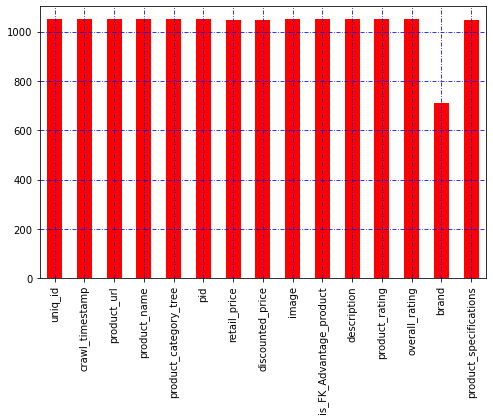

In [12]:
data.notna().sum().plot(kind = 'bar',color = 'red', figsize=(8,5))
plt.xticks(rotation=90)
plt.grid(True, color='blue', dashes=(5,2,1,2))

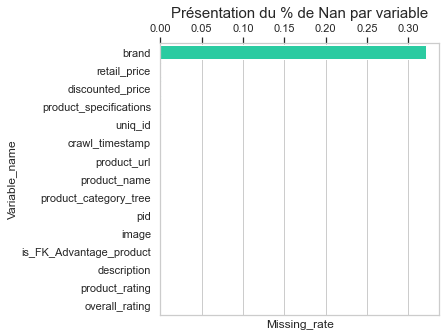

In [13]:
sns.set(style="whitegrid")
plt.figure(figsize=(5, 5))
ax = sns.barplot(x = mssng_val['Missing_rate'], y = mssng_val['Variable_name'], orient = 'h',color = '#11E5AD' )
ax.xaxis.set_ticks_position('top')
plt.title('Présentation du % de Nan par variable', size=15)
plt.show()

In [14]:
data.describe(include='all')

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1049.000000,1049.000000,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,NaN,NaN,1050,2,1050,27,27,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,2015-12-01 12:40:44 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,NaN,NaN,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,150,1,1,56,1,NaN,NaN,1,993,1,889,889,11,22
mean,NaN,NaN,NaN,NaN,NaN,NaN,2186.197331,1584.527169,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,7639.229411,7475.099680,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,35.000000,35.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,555.000000,340.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,999.000000,600.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,1999.000000,1199.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
data

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ..."
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jpg,False,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,No rating available,No rating available,Uberlyfe,"{""product_specification""=>[{""key""=>""Number of ..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-medium-viny...,Wallmantra Medium Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >.

In [16]:
data['product_category_tree'].sample(20)

290    ["Home Decor & Festive Needs >> Decorative Lig...
659    ["Home Furnishing >> Curtains & Accessories >>...
823    ["Watches >> Wrist Watches >> Firstrace Wrist ...
13     ["Watches >> Wrist Watches >> Titan Wrist Watc...
741    ["Watches >> Wrist Watches >> Fogg Fashion Sto...
625    ["Home Decor & Festive Needs >> Decorative Lig...
446    ["Computers >> Laptop Accessories >> Laptop Ad...
144    ["Kitchen & Dining >> Coffee Mugs >> Rockmantr...
140    ["Kitchen & Dining >> Coffee Mugs >> Rockmantr...
740    ["Computers >> Laptop Accessories >> Anti Dust...
48     ["Kitchen & Dining >> Coffee Mugs >> AKUP Coff...
829    ["Computers >> Laptop Accessories >> USB Gadge...
860    ["Computers >> Laptop Accessories >> USB Gadge...
233    ["Home Decor & Festive Needs >> Showpieces >> ...
210    ["Home Decor & Festive Needs >> Showpieces >> ...
299    ["Home Decor & Festive Needs >> Showpieces >> ...
982    ["Baby Care >> Infant Wear >> Baby Boys' Cloth...
50     ["Kitchen & Dining >> Co

In [17]:
data['product_category_tree']

0       ["Home Furnishing >> Curtains & Accessories >>...
1       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
2       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
3       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
4       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
                              ...                        
1045    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1046    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1047    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1048    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1049    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
Name: product_category_tree, Length: 1050, dtype: object

In [18]:
data['product_category_tree'].apply(lambda x: x.count('>>')).max()

6

In [19]:
item = data['product_category_tree'].iloc[0]

In [20]:
item

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

In [21]:
item.split('>>')[1].strip()

'Curtains & Accessories'

In [22]:
item.split('>>')[0].split('"')[1].strip()

'Home Furnishing'

<AxesSubplot:>

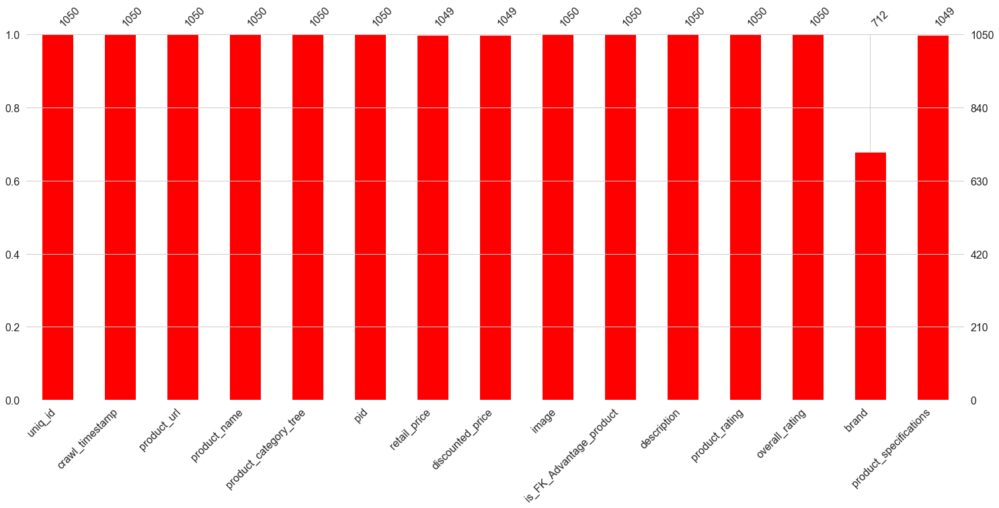

In [23]:
import missingno as msn
msn.bar(data, color= 'red')

In [24]:
def clean(item):
    a  = item.split('>>')[0].split('"')[1].strip()
    return a
def clean_2(item):
    b  = item.split('>>')[1].strip()
    return b

In [25]:
data['cat_1'] = data['product_category_tree'].apply(clean)
data['cat_2'] = data['product_category_tree'].apply(clean_2)

In [26]:
data

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_1,cat_2
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,Baby Bath & Skin
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Bed Linen
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,Bed Linen
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ...",Baby Care,Baby & Kids Gifts
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ...",Baby Care,Baby & Kids Gifts
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jpg,False,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,No rating available,No rating available,Uberlyfe,"{""product_specification""=>[{""key""=

In [27]:
data['cat_1'].value_counts(), data['cat_2'].value_counts()

(Home Furnishing               150
 Baby Care                     150
 Watches                       150
 Home Decor & Festive Needs    150
 Kitchen & Dining              150
 Beauty and Personal Care      150
 Computers                     150
 Name: cat_1, dtype: int64,
 Wrist Watches                        149
 Laptop Accessories                    87
 Infant Wear                           84
 Coffee Mugs                           74
 Showpieces                            71
                                     ... 
 Candles & Fragrances                   1
 Consumables & Disposables              1
 JMD Home Furnishing                    1
 TRUE Home Decor & Festive Needs"]      1
 Beauty Accessories                     1
 Name: cat_2, Length: 63, dtype: int64)

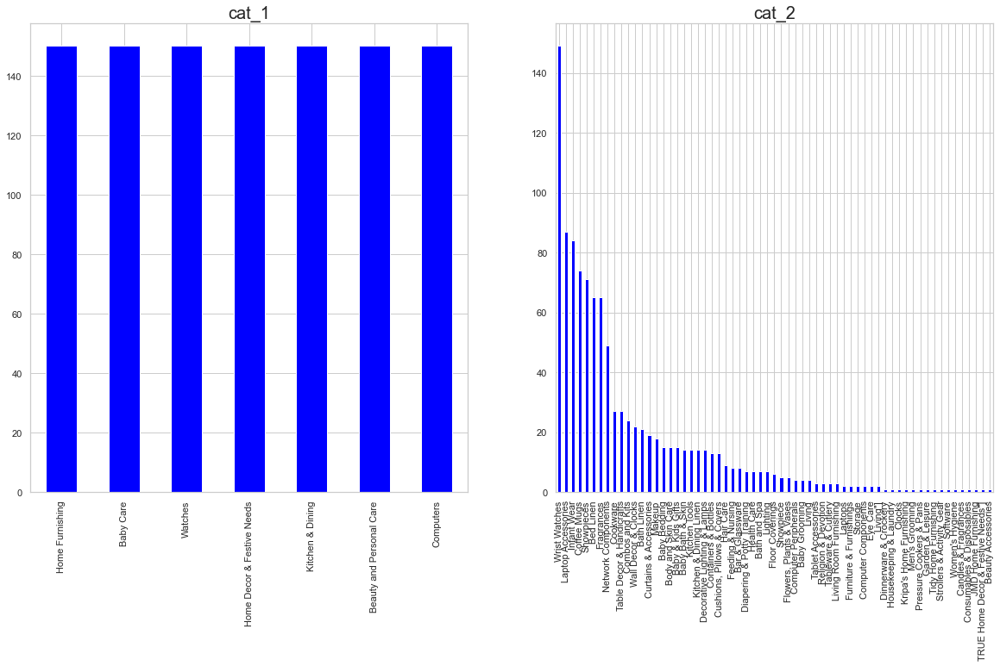

In [28]:
fig, axes = plt.subplots(1, 2, figsize=(20,10))

axes = axes.flatten()
for col, ax in zip(['cat_1','cat_2'], axes):
    data[col].value_counts().plot(kind='bar', color='blue', ax=ax)
    ax.set_title(col, fontsize= 20)
plt.show()

# 2. Traitement du texte NLP
## 2.1 Sélection de features intéressants:
***

In [29]:
data_mdl = data[['uniq_id','product_name','discounted_price','image','description','cat_1','cat_2']]

In [30]:
for txt in data_mdl['description'].sample(20).values:
    print(txt)
    print('\n\n')

Prithish Merry Christmas Design 4 Double Color Ceramic Mug (330 ml)
                         Price: Rs. 225
				
			"Get talking with your coffee! Our wide selection of cute and catchy designs means you're sure to find the quote that says what it is, the way it is. And if these mugs bring on the smiles, don't forget to share them. Mugs like these make great gifts! Each mug is beautifully designed with quality ink and attractive graphics, perfect for all around enjoyment." "Express yourself! Our distinctive coffee mugs give you the freedom to broadcast your own special message, from holiday cheer to your love of cupcakes. These affordable mugs are also perfect for gifting, so you can show others just how well you know them. Break out the mugs, and bring on the laughs! Happy sipping!
"Get talking with your coffee! Our wide selection of cute and catchy designs means you're sure to find the quote that says what it is, the way it is. And if these mugs bring on the smiles, don't forget to sh

In [31]:
for txt in data_mdl[data_mdl['cat_1']== 'Baby Care']['description'].sample(10).values:
    print(txt)
    print('\n\n')

Key Features of Wow! Baby Girl's Gathered Yellow Dress Summer Cotton Frocks Fully Front Open Easy to Put On Suitable for Home Wear Suitable for Newborns Easy to Layer,Wow! Baby Girl's Gathered Yellow Dress Price: Rs. 599 This is a special garment from WOW! All kids will look stylish and cute in WOW! Garments which follow all the latest fashion trends. A must buy for your loved one!,Specifications of Wow! Baby Girl's Gathered Yellow Dress Dimensions Length Mini/Short General Details Pattern Printed Ideal For Baby Girl's Occasion Casual Dress Details Sleeve Sleeveless Fabric Cotton Type Gathered Neck Round Neck



Specifications of Boreal Plastic rectangular hair brush 633D Brush Traits Brush Type Flat brush Brush Set Content Small brush Bristle Type Nylon bristles Round Tip Bristle Yes Handle Type Plastic handle Brush Application Grooming, Curling, Detangling Ideal For BoysIIGirls Brush Size Small Brush Set No Suitable Hair Type Medium to long hair, Wet hair In the Box Hair brush Additi

In [32]:
data_mdl.loc[0,'product_name']

'Elegance Polyester Multicolor Abstract Eyelet Door Curtain'

## 2.2 Préparation et traitement du texte
***


    * Une première approche d'optimisation a montré que certaines étapes de traitement sont toujours bénéfiques pour les modèles. Nous allons procéder à ces étapes avant toute autre optimisation :

    * passer les majuscules en minuscule,
    * conserver uniquement les caractères alphabétiques
    * suppression des mots vides et des lettres simples
    * lemmatisation
    * ne garder que les noms et les adjectifs

Bag of words (tfIdf + Count Vectorizer) + lemmatisation + sortir les stopwords + clustering (Kmeans ou LDA)

In [33]:
#from sklearn.model_selection import train_test_split
#train, test = train_test_split(data_impt, test_size = 0.25, random_state=42)

In [34]:
data_mdl.head(3)

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin


## 2.2.1 Foncts pour le traitement et nettoyage du texte

2.2.1.1 Punctuation list
***

In [35]:
from string import punctuation
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize, regexp_tokenize

stop_word_punct = regexp_tokenize(punctuation, "[\W]+" ) # \W any non word character

In [36]:
stop_word_punct

['!"#$%&\'()*+,-./:;<=>?@[\\]^', '`{|}~']

2.2.1.2 Fonction de Tokenization
***

In [37]:
# Tokenizer ( découpage en mot)
# word_tokenize aide à séparer le texte en mot
def tokenizer_fct(sentence):
   
    word_tokens = word_tokenize(sentence)# séparer par mot
    word_tokens_clean =[w for w in word_tokens if not w in stop_word_punct] 
    
    # sentence_clean = sentence.replace('_', ' ').replace('+', ' ').replace('/', ' ').replace('#', ' ')
    return word_tokens_clean

In [38]:
import re
import string
def clean_text(text):
    '''Remove text in square brackets;
       remove links;
       remove punctuation;
       and remove words containing numbers.'''
    
    #text = re.sub('\[.*?\]', '', text) # tout ce qui est entre deux crochets
    #text = re.sub('http?\S+|https?\S+|www[^\s]+', '', text)    # ^\s qui commence par,\S matches any non-whitespace character, 
    # +: 1 or more, ?: 0 or 1
    text = re.sub('(hhtp?|https?|www)[^\s]+', ' ', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), ' ', text) # enlever la ponctuation
    text = re.sub('\n', '', text)                                    # saute ligne
    text = re.sub('\w*\d\w*', '', text)                              # \w[a-zA-Z0-9_], *: 0 or more, \d:[0-9]
    text = re.sub('\s\s+', ' ', text)           # remplacer plusieur espaces par un seul

    return text 


In [39]:
test_ ="'Key Features ####of KKKK http://rrr.com, wwwwwww https Elegance www.google.com Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you get the right amount of sunlight.,Specifications of Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) General Brand Elegance Designed For Door Type Eyelet Model Name Abstract Polyester Door Curtain Set Of 2 Model ID Duster25 Color Multicolor Dimensions Length 213 cm In the Box Number of Contents in Sales Package Pack of 2 Sales Package 2 Curtains Body & Design Material Polyester'"
clean_text(test_)

' Key Features of KKKK Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain Elegance Polyester Multicolor Abstract Eyelet Door Curtain cm in Height Pack of Price Rs This curtain enhances the look of the interiors This curtain is made from high quality polyester fabric It features an eyelet style stitch with Metal Ring It makes the room environment romantic and loving This curtain is ant wrinkle and anti shrinkage and have elegant apparance Give your home a bright and modernistic appeal with these designs The surreal attention is sure to steal hearts These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening you create the most special moments of joyous beauty given by the soothing prints Bring home the elegant curtain that softly filters light in your room so that you get the right amou

In [40]:
#nltk.download()

#from string import punctuation
#from nltk.corpus import stopwords
#stopwords_en = set(["a","a's","able","about","above","according","accordingly","across","actually","after","afterwards","again","against","ain't","all","allow","allows","almost","alone","along","already","also","although","always","am","among","amongst","an","and","another","any","anybody","anyhow","anyone","anything","anyway","anyways","anywhere","apart","appear","appreciate","appropriate","are","aren't","around","as","aside","ask","asking","associated","at","available","away","awfully","b","be","became","because","become","becomes","becoming","been","before","beforehand","behind","being","believe","below","beside","besides","best","better","between","beyond","both","brief","but","by","c","c'mon","c's","came","can","can't","cannot","cant","cause","causes","certain","certainly","changes","clearly","co","com","come","comes","concerning","consequently","consider","considering","contain","containing","contains","corresponding","could","couldn't","course","currently","d","definitely","described","despite","did","didn't","different","do","does","doesn't","doing","don't","done","down","downwards","during","e","each","edu","eg","eight","either","else","elsewhere","enough","entirely","especially","et","etc","even","ever","every","everybody","everyone","everything","everywhere","ex","exactly","example","except","f","far","few","fifth","first","five","followed","following","follows","for","former","formerly","forth","four","from","further","furthermore","g","get","gets","getting","given","gives","go","goes","going","gone","got","gotten","greetings","h","had","hadn't","happens","hardly","has","hasn't","have","haven't","having","he","he's","hello","help","hence","her","here","here's","hereafter","hereby","herein","hereupon","hers","herself","hi","him","himself","his","hither","hopefully","how","howbeit","however","i","i'd","i'll","i'm","i've","ie","if","ignored","immediate","in","inasmuch","inc","indeed","indicate","indicated","indicates","inner","insofar","instead","into","inward","is","isn't","it","it'd","it'll","it's","its","itself","j","just","k","keep","keeps","kept","know","known","knows","l","last","lately","later","latter","latterly","least","less","lest","let","let's","like","liked","likely","little","look","looking","looks","ltd","m","mainly","many","may","maybe","me","mean","meanwhile","merely","might","more","moreover","most","mostly","much","must","my","myself","n","name","namely","nd","near","nearly","necessary","need","needs","neither","never","nevertheless","new","next","nine","no","nobody","non","none","noone","nor","normally","not","nothing","novel","now","nowhere","o","obviously","of","off","often","oh","ok","okay","old","on","once","one","ones","only","onto","or","other","others","otherwise","ought","our","ours","ourselves","out","outside","over","overall","own","p","particular","particularly","per","perhaps","placed","please","plus","possible","presumably","probably","provides","q","que","quite","qv","r","rather","rd","re","really","reasonably","regarding","regardless","regards","relatively","respectively","right","s","said","same","saw","say","saying","says","second","secondly","see","seeing","seem","seemed","seeming","seems","seen","self","selves","sensible","sent","serious","seriously","seven","several","shall","she","should","shouldn't","since","six","so","some","somebody","somehow","someone","something","sometime","sometimes","somewhat","somewhere","soon","sorry","specified","specify","specifying","still","sub","such","sup","sure","t","t's","take","taken","tell","tends","th","than","thank","thanks","thanx","that","that's","thats","the","their","theirs","them","themselves","then","thence","there","there's","thereafter","thereby","therefore","therein","theres","thereupon","these","they","they'd","they'll","they're","they've","think","third","this","thorough","thoroughly","those","though","three","through","throughout","thru","thus","to","together","too","took","toward","towards","tried","tries","truly","try","trying","twice","two","u","un","under","unfortunately","unless","unlikely","until","unto","up","upon","us","use","used","useful","uses","using","usually","uucp","v","value","various","very","via","viz","vs","w","want","wants","was","wasn't","way","we","we'd","we'll","we're","we've","welcome","well","went","were","weren't","what","what's","whatever","when","whence","whenever","where","where's","whereafter","whereas","whereby","wherein","whereupon","wherever","whether","which","while","whither","who","who's","whoever","whole","whom","whose","why","will","willing","wish","with","within","without","won't","wonder","would","wouldn't","x","y","yes","yet","you","you'd","you'll","you're","you've","your","yours","yourself","yourselves","z","zero"])
#stopwords_nltk = set(stopwords.words('english'))
#stopwords_punct = set(punctuation)
# stopwords_combined = set.union(stopwords_en, stopwords_nltk, stopwords_punct)

2.2.1.3 Fonction de filtrage Stop_word 
***

In [41]:
# Stop words
from nltk.corpus import stopwords
stop_w = list(set(stopwords.words('english'))) 

# + ["[", "]", "," , ".", ":", "?", "(", ")"]
def stop_word_filter_fct(list_words) :
    filtered_w = [w for w in list_words if not w in stop_w]
    filtered_w2 = [w for w in filtered_w if len(w) > 2]
    return filtered_w2

In [42]:
stop_w

['on',
 'in',
 'themselves',
 'between',
 'into',
 't',
 'he',
 'so',
 'isn',
 'than',
 'such',
 'hasn',
 'as',
 'were',
 'other',
 'they',
 'where',
 'again',
 'shouldn',
 'ours',
 'at',
 'm',
 'from',
 'only',
 'all',
 "wouldn't",
 "that'll",
 'our',
 'has',
 "weren't",
 'until',
 're',
 'been',
 'below',
 'did',
 'that',
 'she',
 'is',
 'how',
 'their',
 'above',
 "aren't",
 'yourself',
 'during',
 'herself',
 'y',
 'we',
 "haven't",
 'not',
 'am',
 'some',
 'for',
 'an',
 'whom',
 'before',
 "needn't",
 'both',
 'ourselves',
 'yours',
 'own',
 "doesn't",
 'few',
 'more',
 'my',
 'was',
 'couldn',
 'ain',
 'd',
 "shan't",
 'each',
 've',
 'no',
 'yourselves',
 'then',
 'just',
 'do',
 'and',
 'with',
 'her',
 "shouldn't",
 'weren',
 'while',
 "she's",
 "mightn't",
 'haven',
 'wouldn',
 'are',
 'nor',
 'which',
 'if',
 'under',
 'these',
 'mightn',
 'it',
 'about',
 'himself',
 'theirs',
 'very',
 'your',
 'what',
 'doesn',
 "hasn't",
 "you're",
 'can',
 'to',
 'his',
 'hers',
 'them

 2.2.1.4. Fonction pour le passage en miniscule (lower case)
 ***

In [43]:
# lower case et alpha
def lower_start_fct(list_words) :
    lw = [w.lower() for w in list_words if (not w.startswith("@")) 
    #                                   and (not w.startswith("#"))
                                       and (not w.startswith("http"))]
    return lw

 2.2.1.5. Fonction de (Lemmatizer funct)
 ****

In [44]:
# Lemmatizer (base d'un mot Ex: chiens >> chien)
from nltk.stem import WordNetLemmatizer

def lemma_fct(list_words) :
    lemmatizer = WordNetLemmatizer()
    lem_w = [lemmatizer.lemmatize(w) for w in list_words]
    return lem_w

 2.2.1.6 Fonction pour BOW (Countvectorizer et Tf_idf, Word2Vec)
 ***


In [45]:
# Fonction de préparation du texte pour le bag of words (Countvectorizer et Tf_idf, Word2Vec)
def transform_bow_fct(desc_text) :
    ct = clean_text(desc_text)
    word_tokens = tokenizer_fct(ct)
    sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(sw)
    #lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

 2.2.1.7 Fonction de préparation BOW avec lemmatization
 ***


In [46]:
# Fonction de préparation du texte pour le bag of words avec lemmatization
def transform_bow_lem_fct(desc_text) :
    ct = clean_text(desc_text)
    word_tokens = tokenizer_fct(ct)
    sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(sw)
    lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lem_w)
    return transf_desc_text

 2.2.1.8 Fonction de préparation du texte pour le Deep learning (USE et BERT)
 ***

In [47]:
# Fonction de préparation du texte pour le Deep learning (USE et BERT)
def transform_dl_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)
#    sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(word_tokens)
    # lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

In [48]:
data_mdl['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

    * Exemple de texte pour le bag of words sans lemmatisation:
        * word tokens
        * stop word 
        * lower case et sans lemmatisation

In [49]:
# Texte sans word tokens,stop word et lower case sans lemmatisation
data_mdl['sentence_bow'] = data_mdl['description'].apply(lambda x : transform_bow_fct(x))

In [50]:
data_mdl['sentence_bow'].iloc[0]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain height pack price this curtain enhances look interiors this curtain made high quality polyester fabric features eyelet style stitch metal ring makes room environment romantic loving this curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal designs the surreal attention sure steal hearts these contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room get right amount sunlight specifications elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance designed for door type eyelet model name abstract polyester door curtain set model color multicolor dimensions leng

* Exemple d'un texte pour le bag of words avec lemmatization:
    * word tokens
    * stop word 
    * lower case 
    * lemmatisation

In [51]:
# Texte sans word tokens,stop word avec lower case et lemmatisation
data_mdl['sentence_bow_lem'] = data_mdl['description'].apply(lambda x : transform_bow_lem_fct(x))

In [52]:
data_mdl['sentence_bow_lem'].iloc[0]

'key feature elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain height pack price this curtain enhances look interior this curtain made high quality polyester fabric feature eyelet style stitch metal ring make room environment romantic loving this curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal design the surreal attention sure steal heart these contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright sun ray want wish good morning whole world draw close evening create special moment joyous beauty given soothing print bring home elegant curtain softly filter light room get right amount sunlight specification elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance designed for door type eyelet model name abstract polyester door curtain set model color multicolor dimension length box number

***
* Exemple d'un texte pour le Deep learning (USE et BERT):
    * word tokens
    * lower case sans lemmatization, sans enlever les stop word 


In [53]:
data_mdl['sentence_dl'] = data_mdl['description'].apply(lambda x : transform_dl_fct(x))
data_mdl['sentence_dl'].iloc[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain , elegance polyester multicolor abstract eyelet door curtain ( 213 cm in height , pack of 2 ) price : rs . 899 this curtain enhances the look of the interiors.this curtain is made from 100 % high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs . the surreal attention is sure to steal hearts . these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening , you create the most special moments of joyous beauty given by the soothing prints . bring home the elegant curtain that softly filters light in your room

In [54]:
# Import des librairies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import pickle
import time
from sklearn import cluster, metrics
from sklearn import manifold, decomposition
import logging

logging.disable(logging.WARNING) # disable WARNING, INFO and DEBUG logging everywhere


In [55]:
data_mdl.shape

(1050, 10)

In [56]:
data_mdl.head(3)

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,key features elegance polyester multicolor abs...,key feature elegance polyester multicolor abst...,key features of elegance polyester multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...,specifications of sathiyas cotton bath towel (...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,key features eurospa cotton terry face towel s...,key feature eurospa cotton terry face towel se...,key features of eurospa cotton terry face towe...


    * Length of categ

In [57]:
len_cat = list(set(data_mdl['cat_1']))

y_cat_num = [(1-len_cat.index(data_mdl.iloc[i]['cat_1'])) for i in range(len(data_mdl))]

In [58]:
len_cat

['Baby Care',
 'Kitchen & Dining',
 'Home Furnishing',
 'Watches',
 'Home Decor & Festive Needs',
 'Beauty and Personal Care',
 'Computers']

In [59]:
len(y_cat_num)

1050

In [60]:
import time

# Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et n° de clusters

def ARI_fct(features,) :
    time1 = time.time()
    num_labels=len(len_cat)
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne)
    
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print('-'*100)
    print("ARI : ", ARI, "time : ", time2)
    print('-'*100)
    return ARI, X_tsne, cls.labels_

In [61]:
# visualisation du Tsne selon les vraies catégories et selon les clusters

def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=len_cat, loc="best", title="Categorie")
    plt.title('Représentation des articles par catégories réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels), loc="best", title="Clusters")
    plt.title('Représentation des articles par clusters')
    plt.show()
    print("ARI : ", ARI)

## 2.2.2 Création du bag of words avec CountVectorizer

    * Instanciation of the CountVectorizer 

In [62]:
# Stop word + punctuatuin
stopwords_nltk = set(stopwords.words('english')) 

stopwords_combined = set.union(stopwords_nltk, stop_word_punct)

In [63]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# création du bag of words (CountVectorizer et Tf-idf)

cvect = CountVectorizer(token_pattern=r"(?u)\b[a-zA-Z_]{2,}\b",
                        stop_words= stopwords_combined, 
                        max_df=0.95, 
                        min_df=1)

cv_fit_trans  = cvect.fit_transform(data_mdl['sentence_bow_lem']) 

In [64]:
cv_fit_trans.toarray().shape


(1050, 4381)

# ACP : pour l'approche combinée

In [65]:
X_ = cvect.transform(data_mdl['sentence_bow_lem']).todense()

In [66]:
X_

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [67]:
txt_PCA_reduit, PCA_txt = PCA_features_reduction(np.asarray(X_), var_threshold=0.95, verbose=True)

Initial number of features: 4381
Number of selected features: 547
Cumulative explained variance:  95.01%


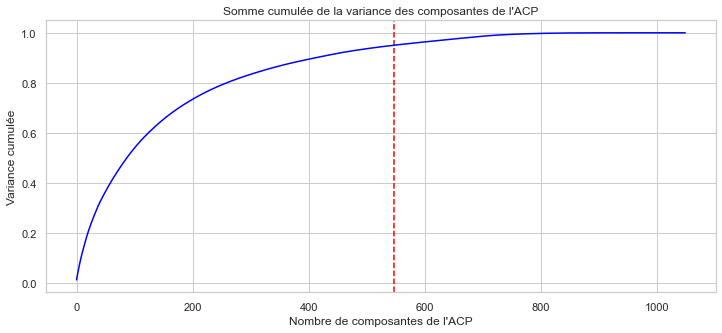

In [68]:
plt.figure(figsize=(12,5))
plt.title("Somme cumulée de la variance des composantes de l'ACP")
plt.xlabel("Nombre de composantes de l'ACP")
plt.ylabel('Variance cumulée')
plt.axvline(547, ls="--", c="red")
plt.plot(list(range(txt_PCA_reduit.shape[0])), np.cumsum(PCA_txt.explained_variance_ratio_), color='blue')

In [69]:
txt_PCA_reduit.shape

(1050, 547)

In [70]:
np.save('D:/Projet Classrooms/Projet_6/data_saved_txt_PCA_reduit_NLP.csv', txt_PCA_reduit)

In [71]:
cvect.get_feature_names()

C:\Users\Win\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['aaa',
 'aapno',
 'aari',
 'aarika',
 'ability',
 'abkl',
 'able',
 'abode',
 'abrasion',
 'abroad',
 'absolute',
 'absorbency',
 'absorbent',
 'absorber',
 'absorbing',
 'absorbs',
 'abstract',
 'abstrcts',
 'accent',
 'access',
 'accessory',
 'accident',
 'accidental',
 'accommodate',
 'accomplishes',
 'according',
 'acer',
 'ache',
 'aching',
 'acid',
 'acne',
 'across',
 'acrylic',
 'act',
 'active',
 'actual',
 'adaa',
 'adapter',
 'adaptor',
 'add',
 'added',
 'addiction',
 'adding',
 'addition',
 'additional',
 'additionally',
 'adhesive',
 'adi',
 'adidas',
 'adino',
 'adjust',
 'adjustable',
 'adjusted',
 'adjusts',
 'admiration',
 'admired',
 'adorable',
 'adorn',
 'adorned',
 'adorning',
 'adsl',
 'advance',
 'advice',
 'advisable',
 'aero',
 'affect',
 'affordable',
 'afternoon',
 'agarwood',
 'age',
 'ageless',
 'aging',
 'agrasen',
 'agrees',
 'agromech',
 'aid',
 'aiding',
 'air',
 'airport',
 'airtel',
 'airtex',
 'airtight',
 'ajmal',
 'akshaj',
 'akup',
 'alarm',
 'a

In [72]:
print('Size of the vocabulary: ',len(list(cvect.vocabulary_)))
print('Number of stop words: ',len(cvect.stop_words_))

Size of the vocabulary:  4381
Number of stop words:  0


In [73]:
cv_fit_trans.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

### 2.2.2.1 Exécution des modèles T-SNE + KMeans + Score ARI

CountVectorizer : 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.4662 time :  15.0
----------------------------------------------------------------------------------------------------



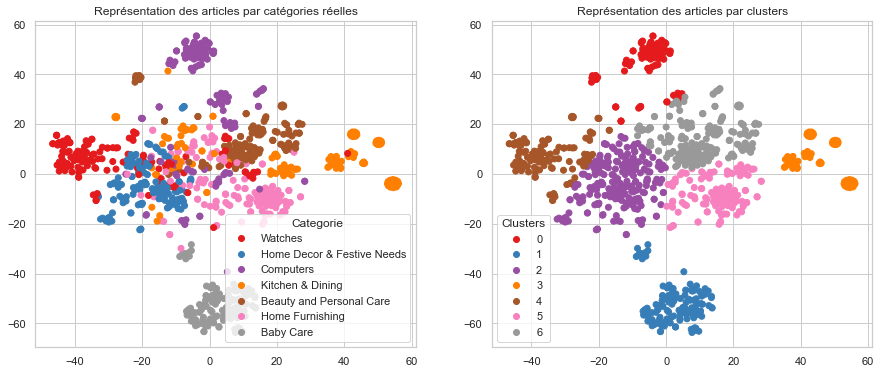

ARI :  0.4662


In [75]:
print("CountVectorizer : ")
print("-"*100)
ARI, X_tsne, labels = ARI_fct(cv_fit_trans)
print()
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

## 2.2.3 Latent Dirichlet Allocation (LDA)
  
    * C’est une méthode non-supervisée générative qui se base sur les hypothèses suivantes :

         Chaque document du corpus est un ensemble de mots sans ordre (bag-of-words);

         Chaque document mm aborde un certain nombre de thèmes dans différentes proportions qui lui sont propres
         p(θm)p(θm);

         Chaque mot possède une distribution associée à chaque thème p(ϕk)p(ϕk) . On peut ainsi représenter chaque thème
          par une probabilité sur chaque mot.

         zn représente le thème du mot wn

    * Puisque l'on a accès uniquement aux documents, on doit déterminer quels sont les thèmes, les distributions de chaque mot sur les thèmes, la fréquence d’apparition de chaque thème sur le corpus.

In [76]:
from sklearn.decomposition import LatentDirichletAllocation

# Initialiser le nombre de topics égale au nombre de catégories
n_topics = 7

# Instanciate LDA
lda = LatentDirichletAllocation(n_components = n_topics, 
                                max_iter=5, 
                                learning_method='online', 
                                learning_offset=50.,
                                random_state=0
                               )
# Entrainement du modèle
lda = lda.fit(cv_fit_trans)

# Transform
text_LDA = lda.transform(cv_fit_trans)

In [77]:
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic {}:\n".format(topic_idx))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))
        print(" ")

In [78]:
no_top_words = 10
display_topics(lda, cvect.get_feature_names_out(), no_top_words)

Topic 0:

laptop skin baby warranty specification type set print general shape
 
Topic 1:

design pack inch feature wall color sticker material home quality
 
Topic 2:

product free delivery buy shipping cash genuine day replacement guarantee
 
Topic 3:

usb battery bowl box singing crystal quality product fan jewellery
 
Topic 4:

polyester eyelet curtain aroma door window sstudio comfort pant gown
 
Topic 5:

bowl brow mask terracotta frame handmade bengal ornamental village diviniti
 
Topic 6:

mug ceramic coffee perfect gift one design material tea loved
 


### 2.2.3.1 Classifier SVC sur jeu de données  LDA

In [79]:
train_txt, test_txt = train_test_split(data_mdl, test_size = 0.25, random_state=42)

In [80]:
train_txt.shape, test_txt.shape

((787, 10), (263, 10))

In [81]:
train_txt.head(2)

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
165,785b4383b12106dd172306d427d8f7b2,Rockmantra Cute Two Cats Ceramic Mug,349.0,785b4383b12106dd172306d427d8f7b2.jpg,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,Kitchen & Dining,Coffee Mugs,rockmantra cute two cats ceramic mug price giv...,rockmantra cute two cat ceramic mug price give...,rockmantra cute two cats ceramic mug ( 5.5 l )...
248,45d0af2c709de47268c80c35a117de44,Malhar Niko Male Doll Showpiece - 25 cm,5436.0,45d0af2c709de47268c80c35a117de44.jpg,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,Home Decor & Festive Needs,Showpieces,buy malhar niko male doll showpiece online mal...,buy malhar niko male doll showpiece online mal...,buy malhar niko male doll showpiece - 25 cm fo...


In [82]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
params = {'C' : [0.01, 0.1, 0.5, 0.9, 1, 1.1]}
svc = GridSearchCV(SVC(), param_grid = params, cv=5)

In [83]:
# création du bag of words (CountVectorizer et Tf-idf)

cvect_spv_lda = CountVectorizer(token_pattern=r"(?u)\b[a-zA-Z_]{2,}\b",
                        stop_words= stopwords_combined, 
                        max_df=0.95, 
                        min_df=1)

cv_spv_lda  = cvect_spv_lda.fit_transform(train_txt['sentence_bow_lem']) 

In [84]:
cv_spv_lda.shape

(787, 3646)

In [85]:
# Instanciate LDA
lda_txt = LatentDirichletAllocation(n_components = data_mdl['cat_2'].nunique(), 
                                max_iter=5, 
                                learning_method='online', 
                                learning_offset=50.,
                                random_state=0
                               )
# Entrainement du modèle
lda_ = lda_txt.fit(cv_spv_lda)


In [86]:
display_topics(lda_, cvect_spv_lda.get_feature_names_out(), no_top_words)

Topic 0:

hair conditioner tigi trait type infused goddess head colour oil
 
Topic 1:

cotton cotonex pack design yellow set green package sale glove
 
Topic 2:

mug coffee tea perfect one ceramic printland made fantastic enjoy
 
Topic 3:

free product delivery genuine shipping cash buy day replacement guarantee
 
Topic 4:

intex inflatable air chair dress kid gathered detail baby cotton
 
Topic 5:

dhol admiration beyoutiful repouss shop copper drawing surity exclusive man
 
Topic 6:

baby cotton detail fabric color specification girl general boy type
 
Topic 7:

idli plate idlis maker vatika dhokla tallenge survive embroidered ware
 
Topic 8:

brass watch hanging wall ganesha leaf creative model showpiece height
 
Topic 9:

com flipkart day shipping buy cash delivery genuine product guarantee
 
Topic 10:

cap shower purple diameter eye baby shampoo head le washed
 
Topic 11:

ocean glassware glass clear retail asia manufacturer leading multipurpose inception
 
Topic 12:

com flipkart

In [87]:
# Transform
#lda_.transform(cv_spv_lda)[1,:]

In [88]:
#lda_.transform(cvect_spv_lda.transform(test_txt['sentence_bow_lem']))

In [89]:
lda_.transform(cvect_spv_lda.transform(train_txt['sentence_bow_lem'])).shape

(787, 63)

In [90]:
svc.fit(lda_.transform(cvect_spv_lda.transform(train_txt['sentence_bow_lem'])), train_txt['cat_2'])

C:\Users\Win\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:676: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.01, 0.1, 0.5, 0.9, 1, 1.1]})

In [91]:
lda_.transform(cvect_spv_lda.transform(train_txt['sentence_bow_lem'])).shape

(787, 63)

In [92]:
print('-'*100)
print('accuracy sur jeu train : ', 
      accuracy_score(svc.best_estimator_.predict(
          lda_.transform(cvect_spv_lda.transform(train_txt['sentence_bow_lem']))), train_txt['cat_2']))
print('-'*100)
print('accuracy sur jeu test : ', 
      accuracy_score(svc.best_estimator_.predict(
          lda_.transform(cvect_spv_lda.transform(test_txt['sentence_bow_lem']))), test_txt['cat_2']))
print('-'*100)

----------------------------------------------------------------------------------------------------
accuracy sur jeu train :  0.4269377382465057
----------------------------------------------------------------------------------------------------
accuracy sur jeu test :  0.376425855513308
----------------------------------------------------------------------------------------------------


## 2.2.4 TF-IDF + NMF

### 2.2.4.1 Création du bag of words (Tf-idf)

In [93]:
# création du bag of words (Tf-idf)

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# Instanciation of the tf-idf vectorizer
ctf = TfidfVectorizer(stop_words=stopwords_combined, 
                      max_df=0.95, 
                      min_df=1)

# Application of the tf-idf vectorizer
tfidf_fit_trans = ctf.fit_transform(data_mdl['sentence_bow_lem'])
  
# Conversion to a dense array for later use
#tfidf_dense = tfidf_fit_trans.todense()

In [94]:
from nltk.stem import WordNetLemmatizer 

print('Size of the vocabulary: ',len(list(ctf.vocabulary_)))
print('Number of stop words: ',len(ctf.stop_words_))

Size of the vocabulary:  4382
Number of stop words:  0


In [95]:
w =ctf.get_feature_names_out().tolist()
w

['aaa',
 'aapno',
 'aari',
 'aarika',
 'ability',
 'abkl',
 'able',
 'abode',
 'abrasion',
 'abroad',
 'absolute',
 'absorbency',
 'absorbent',
 'absorber',
 'absorbing',
 'absorbs',
 'abstract',
 'abstrcts',
 'accent',
 'access',
 'accessory',
 'accident',
 'accidental',
 'accommodate',
 'accomplishes',
 'according',
 'acer',
 'ache',
 'aching',
 'acid',
 'acne',
 'across',
 'acrylic',
 'act',
 'active',
 'actual',
 'adaa',
 'adapter',
 'adaptor',
 'add',
 'added',
 'addiction',
 'adding',
 'addition',
 'additional',
 'additionally',
 'adhesive',
 'adi',
 'adidas',
 'adino',
 'adjust',
 'adjustable',
 'adjusted',
 'adjusts',
 'admiration',
 'admired',
 'adorable',
 'adorn',
 'adorned',
 'adorning',
 'adsl',
 'advance',
 'advice',
 'advisable',
 'aero',
 'affect',
 'affordable',
 'afternoon',
 'agarwood',
 'age',
 'ageless',
 'aging',
 'agrasen',
 'agrees',
 'agromech',
 'aid',
 'aiding',
 'air',
 'airport',
 'airtel',
 'airtex',
 'airtight',
 'ajmal',
 'akshaj',
 'akup',
 'alarm',
 'a

In [96]:
tfidf_fit_trans.shape

(1050, 4382)

### 2.2.4.2 Exécution des modèles T-SNE + KMeans + Score ARI

Tf-idf : 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.4491 time :  13.0
----------------------------------------------------------------------------------------------------


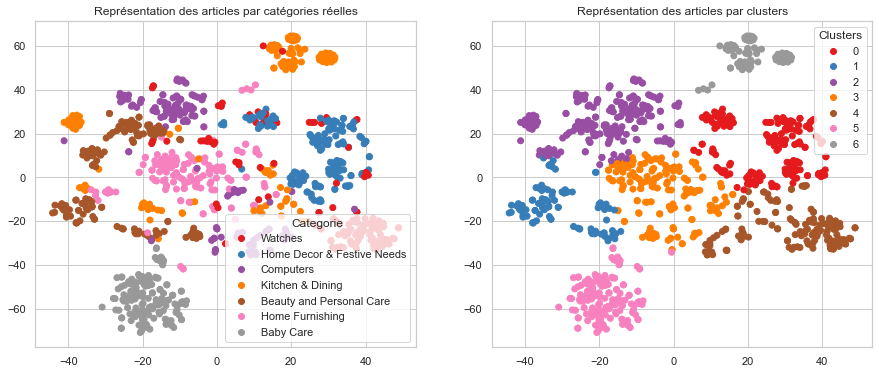

ARI :  0.4491


In [97]:
print("Tf-idf : ")
print("-"*100)
ARI, X_tsne, labels = ARI_fct(tfidf_fit_trans)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### 2.2.5 NMF

* Une autre type de modélisation de sujet automatique non supervisée est NMF (Negative Matrix Factorisation).
***

In [99]:
from sklearn.decomposition import NMF

# NMF is able to use tf-idf

no_topics = 7

# Run NMF
nmf = NMF(n_components=no_topics, random_state=1, 
          alpha=.1, l1_ratio=.5, init='nndsvd')
nmf.fit(tfidf_fit_trans)

no_top_words = 10
display_topics(nmf, ctf.get_feature_names_out(), 
               no_top_words)


Topic 0:

com flipkart cash shipping genuine delivery guarantee buy free replacement
 
Topic 1:

watch analog men discount india great woman sonata maximum dial
 
Topic 2:

mug coffee ceramic perfect tea prithish printland one gift get
 
Topic 3:

baby girl detail cotton fabric dress sleeve boy neck pack
 
Topic 4:

rockmantra mug ceramic crafting porcelain permanent thrilling ensuring stay start
 
Topic 5:

laptop battery cell skin warranty pavilion lapguard adapter shape mouse
 
Topic 6:

abstract blanket double single com flipkart quilt comforter buy shipping
 


C:\Users\Win\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1422: FutureWarning: `alpha` was deprecated in version 1.0 and will be removed in 1.2. Use `alpha_W` and `alpha_H` instead
  warnings.warn(


## 2.2.5 Création du modèle Word2Vec

    * Basé sur la recherche de sens des mots

In [117]:
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import gensim

In [154]:
w2v_size=300
w2v_window=10
w2v_min_count=1
w2v_epochs=20
maxlen = 24 # adapt to length of sentences
sentences = data_mdl['sentence_bow_lem'].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [155]:
len(sentences)

1050

In [156]:
sentences

[['key',
  'feature',
  'elegance',
  'polyester',
  'multicolor',
  'abstract',
  'eyelet',
  'door',
  'curtain',
  'floral',
  'curtain',
  'elegance',
  'polyester',
  'multicolor',
  'abstract',
  'eyelet',
  'door',
  'curtain',
  'height',
  'pack',
  'price',
  'this',
  'curtain',
  'enhances',
  'look',
  'interior',
  'this',
  'curtain',
  'made',
  'high',
  'quality',
  'polyester',
  'fabric',
  'feature',
  'eyelet',
  'style',
  'stitch',
  'metal',
  'ring',
  'make',
  'room',
  'environment',
  'romantic',
  'loving',
  'this',
  'curtain',
  'ant',
  'wrinkle',
  'anti',
  'shrinkage',
  'elegant',
  'apparance',
  'give',
  'home',
  'bright',
  'modernistic',
  'appeal',
  'design',
  'the',
  'surreal',
  'attention',
  'sure',
  'steal',
  'heart',
  'these',
  'contemporary',
  'eyelet',
  'valance',
  'curtain',
  'slide',
  'smoothly',
  'draw',
  'apart',
  'first',
  'thing',
  'morning',
  'welcome',
  'bright',
  'sun',
  'ray',
  'want',
  'wish',
  'go

In [157]:
from gensim.models import Word2Vec

In [158]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count = w2v_min_count, 
                                   window=w2v_window,
                                   vector_size=w2v_size,
                                   seed=42,
                                   workers=1)
#                                                workers=multiprocessing.cpu_count())

w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)

model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 4455
Word2Vec trained


### 2.2.5.1 Test de similarité
****

In [159]:
print(model_vectors.similarity('package', 'lot'),'\n************')
print(model_vectors.similarity('girl', 'boy'),'\n************')
print(model_vectors.similarity('yellow', 'red'),'\n************')

0.08573361 
************
0.8860109 
************
0.6878723 
************


In [160]:
model_vectors.most_similar('green')

[('yellow', 0.877837061882019),
 ('bucket', 0.8738964796066284),
 ('pink', 0.8515307307243347),
 ('grey', 0.8319422602653503),
 ('white', 0.819561779499054),
 ('giftsthatwow', 0.8166391253471375),
 ('cactus', 0.8129180073738098),
 ('mini', 0.8124147653579712),
 ('blue', 0.799816906452179),
 ('skyblue', 0.7961534261703491)]

In [161]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 4456


### 2.2.5.2 Création de la matrice d'embedding

In [162]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
w2v_size = 300
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (4456, 300)


In [163]:
embedding_matrix

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [-0.14753066,  0.77548456,  0.44776925, ..., -0.16195858,
        -0.67131948,  0.38881609],
       [-0.50577217,  1.03682077,  0.21819508, ...,  0.06907586,
        -0.16091457,  0.78587449],
       ...,
       [ 0.00776815, -0.027186  ,  0.00814411, ...,  0.02184703,
        -0.02887689,  0.00648784],
       [ 0.0095521 , -0.0233373 ,  0.02822716, ...,  0.013403  ,
        -0.03546835,  0.01672609],
       [ 0.00319166, -0.01409238,  0.02060319, ...,  0.01616389,
        -0.010855  ,  0.04043249]])

### 2.2.5.3 Création du modèle d'embedding

In [164]:
# Création du modèle

input=Input(shape=(len(x_sentences),maxlen),dtype='float64')
word_input=Input(shape=(maxlen,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec = GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding_3 (Embedding)     (None, 24, 300)           1336800   
                                                                 
 global_average_pooling1d_3   (None, 300)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
Total params: 1,336,800
Trainable params: 1,336,800
Non-trainable params: 0
_________________________________________________________________


### 2.2.5.4 Exécution des modèles T-SNE + KMeans + Score ARI


In [165]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 1ms/step


(1050, 300)

In [166]:
embeddings

array([[-0.77487534, -0.5874867 , -0.03573726, ...,  0.28634104,
         0.5999308 ,  0.35025445],
       [-0.8011427 , -0.5799435 , -0.08882552, ...,  0.36982298,
         0.6167619 ,  0.1785754 ],
       [-0.6591386 , -0.5140385 , -0.07885949, ...,  0.3527558 ,
         0.43005872,  0.2761431 ],
       ...,
       [-0.0355035 ,  0.40357783,  0.19646482, ..., -0.01488234,
        -0.2578223 ,  0.6084664 ],
       [ 0.07960138,  0.37829018,  0.1962295 , ...,  0.05393839,
        -0.2807685 ,  0.8249672 ],
       [-0.00257168,  0.43066683,  0.1925928 , ..., -0.02048347,
        -0.24864806,  0.66927814]], dtype=float32)

Word2Vec Embedding : 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.3023 time :  11.0
----------------------------------------------------------------------------------------------------


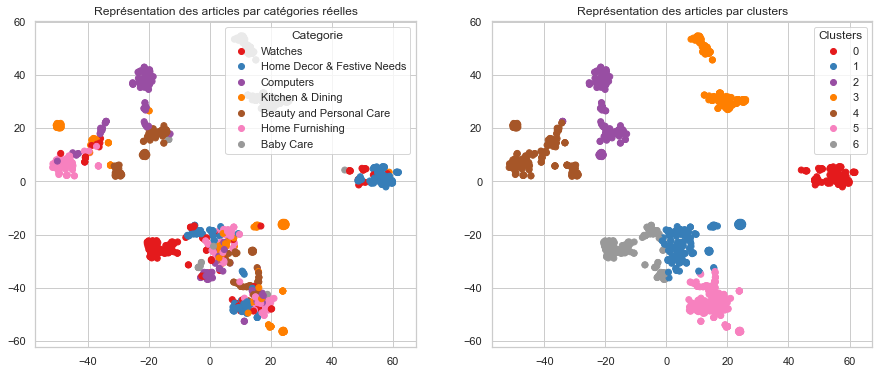

ARI :  0.3023


In [167]:
print("Word2Vec Embedding : ")
print("-"*100)
ARI, X_tsne, labels = ARI_fct(embeddings)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [170]:
import tensorflow as tf
#import tensorflow_hub as hub
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Bert
import os
import transformers
from transformers import *

os.environ["TF_KERAS"]='1'

In [171]:
# Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot

In [172]:
# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)
     
    return features_bert, last_hidden_states_tot

## 2.2.6 BERT hub Tensorflow

In [176]:
import tensorflow_hub as hub
import tensorflow_text 

# Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
         
bert_layer = hub.KerasLayer(model_url, trainable=True)

In [177]:
sentences = data_mdl['sentence_dl'].to_list()

In [178]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert, last_hidden_states_tot = feature_BERT_fct(model, 
                                                         model_type, 
                                                         sentences, 
                                                         max_length, 
                                                         batch_size, 
                                                         mode='TFhub')

temps traitement :  158.0


In [179]:
features_bert

array([[ 0.02145049, -0.12717795,  0.71261454, ..., -0.19578192,
        -0.04661125, -0.1645703 ],
       [ 0.27322924, -0.07208401,  0.56082535, ..., -0.30192614,
        -0.34756088,  0.05372829],
       [ 0.0747126 , -0.12468188,  0.5783907 , ..., -0.23676582,
        -0.19680966, -0.10129165],
       ...,
       [ 0.2726857 , -0.13169287,  0.49569628, ..., -0.00384783,
         0.08430148, -0.06883027],
       [ 0.241534  , -0.08186408,  0.5216383 , ...,  0.01199355,
         0.04899595, -0.22007275],
       [ 0.2511639 , -0.15233466,  0.62894917, ...,  0.01527471,
         0.01614592, -0.17619942]], dtype=float32)

BERT hub Tensorflow : 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.3099 time :  18.0
----------------------------------------------------------------------------------------------------


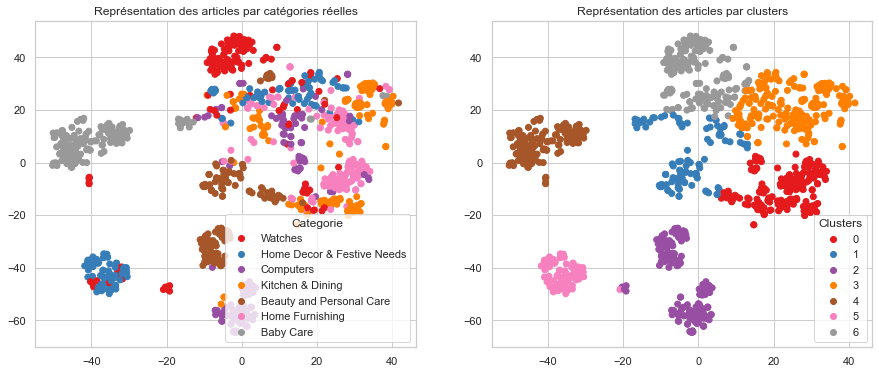

ARI :  0.3099


In [189]:

print("BERT hub Tensorflow : ")
print("-"*100)
ARI, X_tsne, labels = ARI_fct(features_bert)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

## 2.2.7 USE - Universal Sentence Encoder

In [181]:
import tensorflow as tf
#import tensorflow_hub as hub
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Bert
import transformers
from transformers import *

os.environ["TF_KERAS"]='1'

In [182]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.9.1
2.9.1
Num GPUs Available:  0
True


In [183]:
import tensorflow_hub as hub

embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [184]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [185]:
batch_size = 10
sentences = data_mdl['sentence_dl'].to_list()

In [186]:
features_USE = feature_USE_fct(sentences, batch_size)

In [187]:
features_USE

array([[-0.05539608, -0.02782313,  0.01833179, ...,  0.05086442,
         0.04917975, -0.01530948],
       [-0.0512289 , -0.01898725,  0.01227693, ...,  0.0330819 ,
         0.03153948,  0.03463586],
       [-0.05810827,  0.02152601, -0.04410999, ...,  0.05775318,
        -0.05077326, -0.04726291],
       ...,
       [-0.04408048, -0.03755883,  0.03047278, ...,  0.01414982,
         0.05765437, -0.06278041],
       [-0.04686179, -0.0392844 ,  0.04898711, ...,  0.04509434,
        -0.01900146, -0.02946297],
       [-0.05539847, -0.02439286,  0.05092699, ...,  0.04759796,
        -0.02505928, -0.01377851]], dtype=float32)

USE - Universal Sentence Encoder : 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.4491 time :  25.0
----------------------------------------------------------------------------------------------------


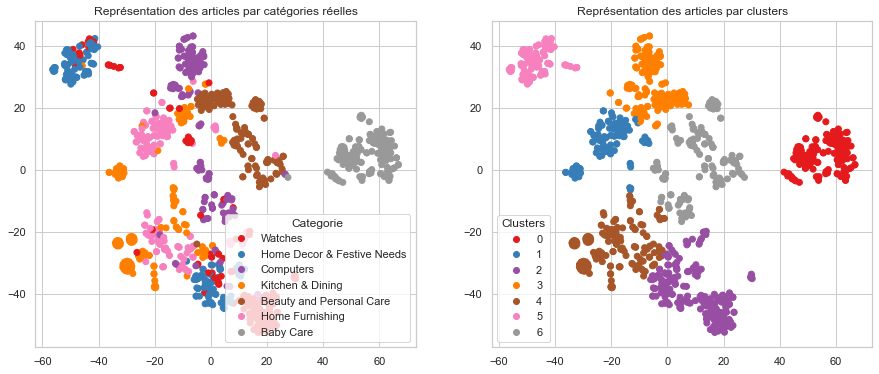

ARI :  0.4491


In [188]:
print("USE - Universal Sentence Encoder : ")
print("-"*100)
ARI, X_tsne, labels = ARI_fct(features_USE)
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)


In [ ]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

 revoir la simirabilité des mot pour Word2Vec tu lui donne un mot il te donne les mots similaire
 revoir la partie clusters et categ pour la ressemblance 
 enlevé la partie les urls sur la partie nmf mais avant le coutvictorize et tf-idf
 ##(hhtp|https|www)[^\s]+ revoir cette partie 

# 3 Traitement d'image
*** 
    * Afin d’extraire les features image, il sera nécessaire de mettre en œuvre :
    * un algorithme de type SIFT / ORB / SURF ;
    * un algorithme de type CNN Transfer Learning.

In [74]:
import os
from P6_Img_Funt import *

import cv2
import PIL as PIL
from PIL import Image, ImageOps, ImageFilter

from PIL.ImageFilter import GaussianBlur

from IPython.display import Image as ShowImage

from scipy import signal
from matplotlib.pyplot import imshow, get_cmap # pour la convolution

from sklearn.decomposition import PCA
#from sklearn.model_selection import train_test_split

In [75]:
data_img = data_mdl.copy()

In [76]:
data_index = data_img['image'].values

In [77]:
#data_img.index = data_index

In [78]:
#data_img.drop(columns='image')

data_mdl


,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,key features elegance polyester multicolor abs...,key feature elegance polyester multicolor abst...,key features of elegance polyester multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...,specifications of sathiyas cotton bath towel (...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,key features eurospa cotton terry face towel s...,key feature eurospa cotton terry face towel se...,key features of eurospa cotton terry face towe...
3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen,key features santosh royal fashion cotton prin...,key feature santosh royal fashion cotton print...,key features of santosh royal fashion cotton p...
4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen,key features jaipur print cotton floral king s...,key feature jaipur print cotton floral king si...,key features of jaipur print cotton floral kin...
...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,Oren Empower Extra Large Self Adhesive Sticker,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Oren Empower Extra Large Self Adhesive Sticker...,Baby Care,Baby & Kids Gifts,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,fd6cbcc22efb6b761bd564c28928483c,Wallmantra Large Vinyl Sticker Sticker,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,Wallmantra Large Vinyl Sticker Sticker (Pack o...,Baby Care,Baby & Kids Gifts,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker ( pack ...
1047,5912e037d12774bb73a2048f35a00009,Uberlyfe Extra Large Pigmented Polyvinyl Films...,1449.0,5912e037d12774bb73a2048f35a00009.jpg,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,Baby Care,Baby & Kids Gifts,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,Wallmantra Medium Vinyl Sticker Sticker,1333.0,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,Baby Care,Baby & Kids Gifts,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker fo...


In [79]:
file_path = "D:\\Projet Classrooms\\Projet_6\\Images\\"

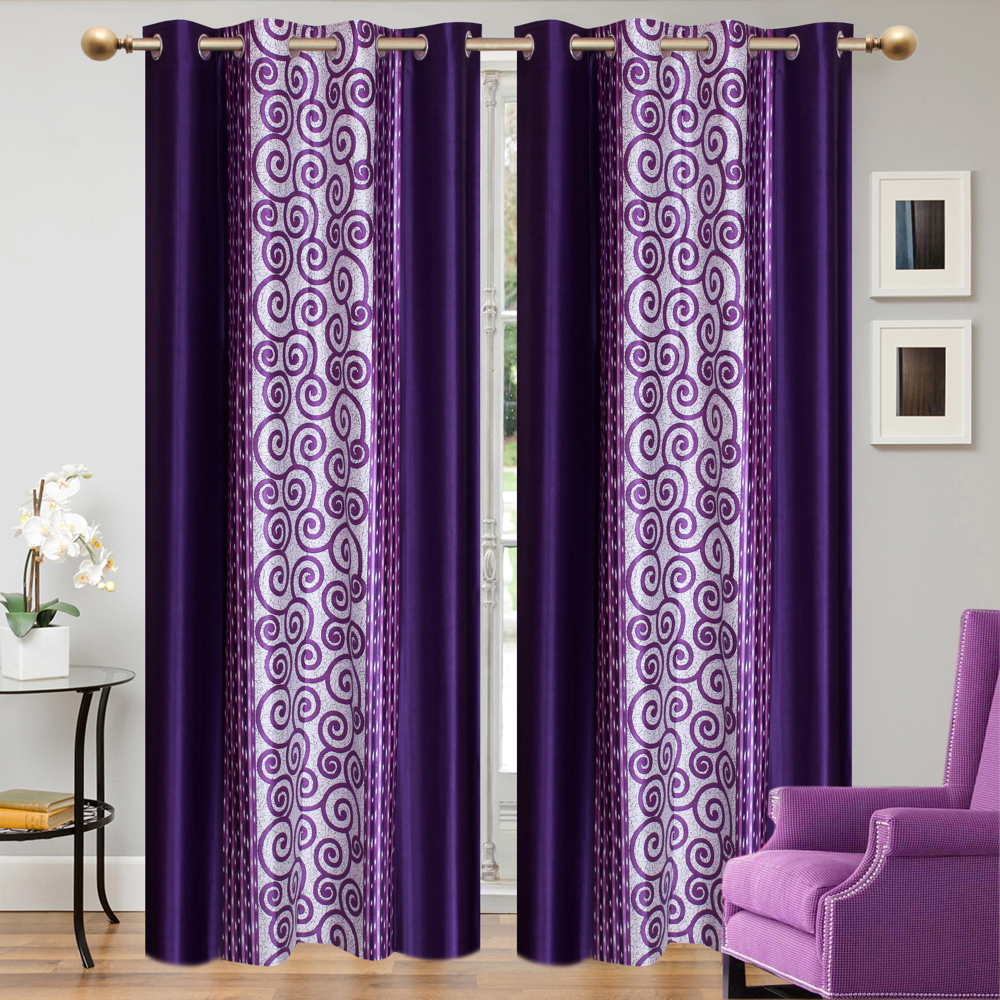

In [80]:
ShowImage(file_path+ str(data_img['image'].values.tolist()[0]), width=300 )

### Test sur un échantillon

    Prétraiter les données pour obtenir un jeu de donnée exploitable
    * Utiliser des librairies spécialisées pour traiter les contrast comme opencv
    * Filtrage du bruit 
    * égaliser l'histogramme


In [81]:
#Echantillon de données
img_test = data_img.sample(10, random_state=10)

In [82]:
img_test['image'] = img_test['image'].apply(lambda x: file_path +str(x))

In [83]:
data_img['image'] = data_img['image'].apply(lambda x: file_path +str(x))

In [84]:
data_img

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,899.0,D:\Projet Classrooms\Projet_6\Images\55b85ea15...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,key features elegance polyester multicolor abs...,key feature elegance polyester multicolor abst...,key features of elegance polyester multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,449.0,D:\Projet Classrooms\Projet_6\Images\7b72c92c2...,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...,specifications of sathiyas cotton bath towel (...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,NaN,D:\Projet Classrooms\Projet_6\Images\64d5d4a25...,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,key features eurospa cotton terry face towel s...,key feature eurospa cotton terry face towel se...,key features of eurospa cotton terry face towe...
3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,1299.0,D:\Projet Classrooms\Projet_6\Images\d4684dcdc...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen,key features santosh royal fashion cotton prin...,key feature santosh royal fashion cotton print...,key features of santosh royal fashion cotton p...
4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,698.0,D:\Projet Classrooms\Projet_6\Images\6325b6870...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen,key features jaipur print cotton floral king s...,key feature jaipur print cotton floral king si...,key features of jaipur print cotton floral kin...
...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,Oren Empower Extra Large Self Adhesive Sticker,999.0,D:\Projet Classrooms\Projet_6\Images\958f54f4c...,Oren Empower Extra Large Self Adhesive Sticker...,Baby Care,Baby & Kids Gifts,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,fd6cbcc22efb6b761bd564c28928483c,Wallmantra Large Vinyl Sticker Sticker,1896.0,D:\Projet Classrooms\Projet_6\Images\fd6cbcc22...,Wallmantra Large Vinyl Sticker Sticker (Pack o...,Baby Care,Baby & Kids Gifts,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker ( pack ...
1047,5912e037d12774bb73a2048f35a00009,Uberlyfe Extra Large Pigmented Polyvinyl Films...,1449.0,D:\Projet Classrooms\Projet_6\Images\5912e037d...,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,Baby Care,Baby & Kids Gifts,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,Wallmantra Medium Vinyl Sticker Sticker,1333.0,D:\Projet Classrooms\Projet_6\Images\c3edc504d...,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,Baby Care,Baby & Kids Gifts,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker fo...


In [85]:
data_img['image'].head(1)

0    D:\Projet Classrooms\Projet_6\Images\55b85ea15...
Name: image, dtype: object

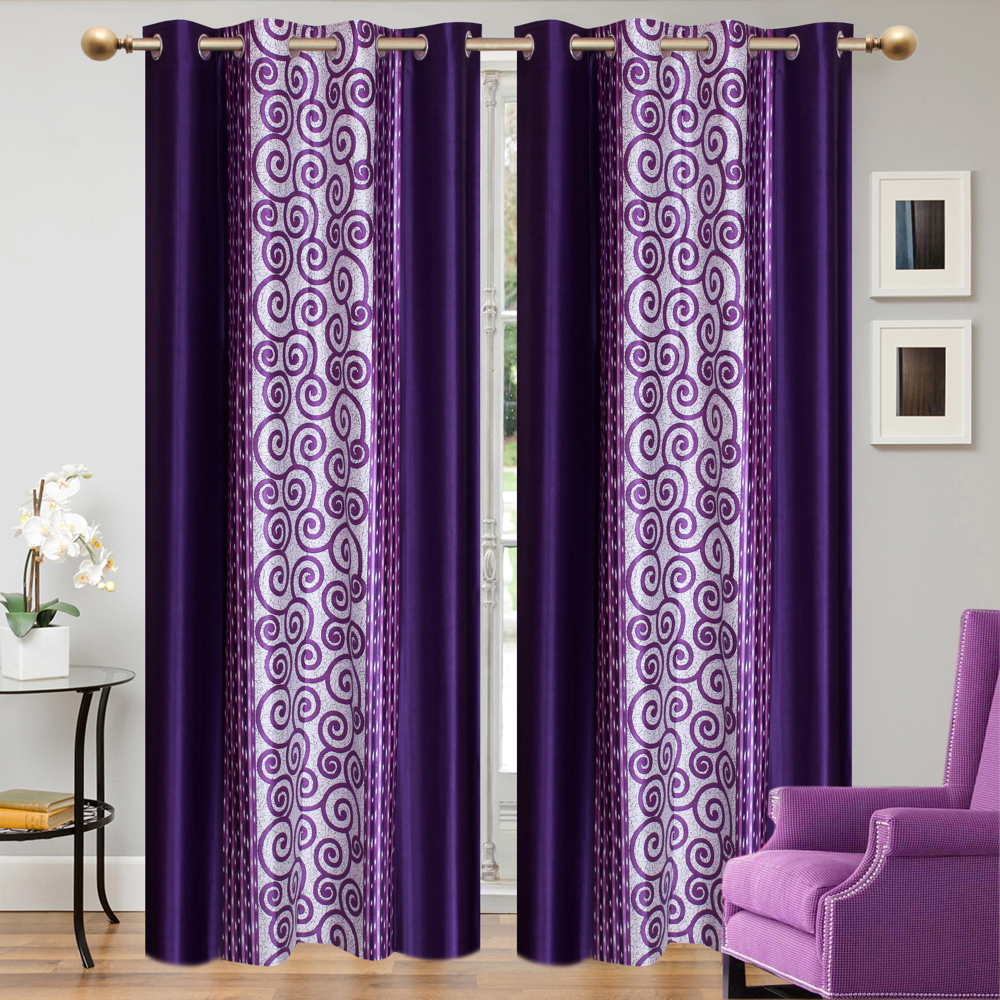

In [86]:
ShowImage(data_img.iloc[0]['image'],  width=100)

In [87]:
img_test

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
775,93618b8a998782d4d847ee5cba5c7de2,Carter'S Self Design Single Blanket Multicolor,980.0,D:\Projet Classrooms\Projet_6\Images\93618b8a9...,Buy Carter'S Self Design Single Blanket Multic...,Baby Care,Baby Bedding,buy carter self design single blanket multicol...,buy carter self design single blanket multicol...,buy carter 's self design single blanket multi...
806,9c06a95a82c3bd6635b9fe6e92b15902,Mxofere Combo Papaya Mixfruit Almond Honey Ora...,285.0,D:\Projet Classrooms\Projet_6\Images\9c06a95a8...,Buy Mxofere Combo Papaya Mixfruit Almond Honey...,Beauty and Personal Care,Combos and Kits,buy mxofere combo papaya mixfruit almond honey...,buy mxofere combo papaya mixfruit almond honey...,buy mxofere combo papaya mixfruit almond honey...
694,0ae859a69c7608d8197c3ba8c37bc6ec,Tallenge Christmas Collection - Echoes Of Wint...,1799.0,D:\Projet Classrooms\Projet_6\Images\0ae859a69...,Tallenge Christmas Collection - Echoes Of Wint...,Home Decor & Festive Needs,Wall Decor & Clocks,tallenge christmas collection echoes winter ga...,tallenge christmas collection echo winter gall...,tallenge christmas collection - echoes of wint...
370,b42a9b597a3a3dc8f428e2e2323e9aff,Anna Andre Paris Floralina & Red Horizon Combo...,249.0,D:\Projet Classrooms\Projet_6\Images\b42a9b597...,Flipkart.com: Buy Anna Andre Paris Floralina &...,Beauty and Personal Care,Fragrances,flipkart com buy anna andre paris floralina re...,flipkart com buy anna andre paris floralina re...,flipkart.com : buy anna andre paris floralina ...
547,987e13b445c34bfedb9796d2bb78d593,Maxima 01727LPLN Mac Gold Analog Watch - For ...,650.0,D:\Projet Classrooms\Projet_6\Images\987e13b44...,Maxima 01727LPLN Mac Gold Analog Watch - For ...,Watches,Wrist Watches,maxima mac gold analog watch for women buy max...,maximum mac gold analog watch for woman buy ma...,maxima 01727lpln mac gold analog watch - for w...
244,0c4718ae90f2889b7021a99ee1cc106c,Bergner Kadhai NA L,1499.0,D:\Projet Classrooms\Projet_6\Images\0c4718ae9...,"Bergner Kadhai NA L (Aluminium, Non-stick)\r\n...",Kitchen & Dining,Cookware,bergner kadhai aluminium non stick price get s...,bergner kadhai aluminium non stick price get s...,"bergner kadhai na l ( aluminium , non-stick ) ..."
369,53c4f1e5cb1767f1a6ba05d32dfaf107,Tenda 3G300M,1718.0,D:\Projet Classrooms\Projet_6\Images\53c4f1e5c...,Buy Tenda 3G300M only for Rs. 3000 from Flipka...,Computers,Network Components,buy tenda flipkart com only genuine products d...,buy tenda flipkart com only genuine product da...,buy tenda 3g300m only for rs . 3000 from flipk...
757,44a6d9f64668b004c3254f3904142064,SVM Navratri Special 7 Analog Watch - For Gir...,244.0,D:\Projet Classrooms\Projet_6\Images\44a6d9f64...,SVM Navratri Special 7 Analog Watch - For Gir...,Watches,Wrist Watches,svm navratri special analog watch for girls wo...,svm navratri special analog watch for girl wom...,svm navratri special 7 analog watch - for girl...
419,e365b55f806e5d0abe0094a9f2590e33,Tenda 3G622R+,1913.0,D:\Projet Classrooms\Projet_6\Images\e365b55f8...,Buy Tenda 3G622R+ only for Rs. 3500 from Flipk...,Computers,Network Components,buy tenda flipkart com only genuine products d...,buy tenda flipkart com only genuine product da...,buy tenda 3g622r+ only for rs . 3500 from flip...
1041,b1644f47c7dfa58f8c06677f2a27ee09,Wallmantra Extra Large Vinyl Stickers Sticker,1216.0,D:\Projet Classrooms\Projet_6\Images\b1644f47c...,Buy Wallmantra Extra Large Vinyl Stickers Stic...,Baby Care,Baby & Kids Gifts,buy wallmantra extra large vinyl stickers stic...,buy wallmantra extra large vinyl sticker stick...,buy wallmantra extra large vinyl stickers stic...


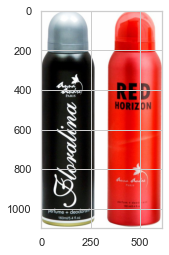

In [88]:
img_cc= cv2.imread(img_test.iloc[3]['image'])
RGB_im = cv2.cvtColor(img_cc, cv2.COLOR_BGR2RGB)
# Display image
plt.imshow(RGB_im)

# Foncts

    * 0. Display of Two Images
    * 1. Resize Image
    * 2. RGB to Grey
    * 3. Gaussian Blur
    * 4. Filtrage Par Convolution
    * 5. Filtre Moyenneur
    * 6. Egaliser l'histogramme
    * 
    
    
****

### Egaliser l'histogramme

    * l'amélioration du contraste de l'image

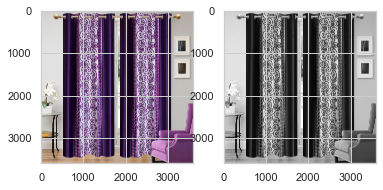

In [89]:
img_11_ = Image.open(file_path + data_mdl.iloc[0]['image'])
img_11 = np.array(img_11_)
img_11 = rgb_to_grey(img_11)
display_two_images(img_11_, img_11)

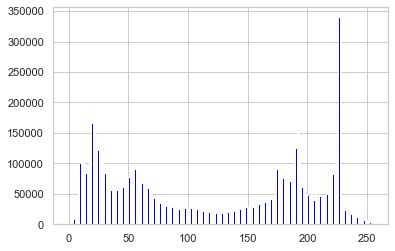

In [90]:

#new_img = cv2.equalizeHist(img)
        # Générer et afficher l'histogramme
        # Pour le normaliser : argument density=True dans plt.hist
        # Pour avoir l'histogramme cumulé : argument cumulative=True
n, bins, patches = plt.hist(img_11.flatten(), bins=range(256),
                            density= False, 
                            cumulative= False,
                           color = 'blue')
plt.show()


In [91]:
im_ = cv2.equalizeHist(img_11)

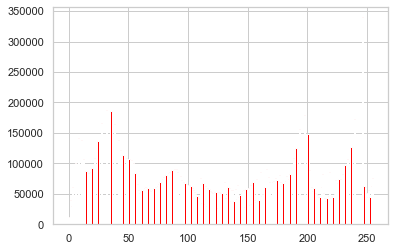

In [92]:
n, bins, patches = plt.hist(im_.flatten(), bins=range(256),
                            density= False, 
                            cumulative= False,
                           color = 'red')

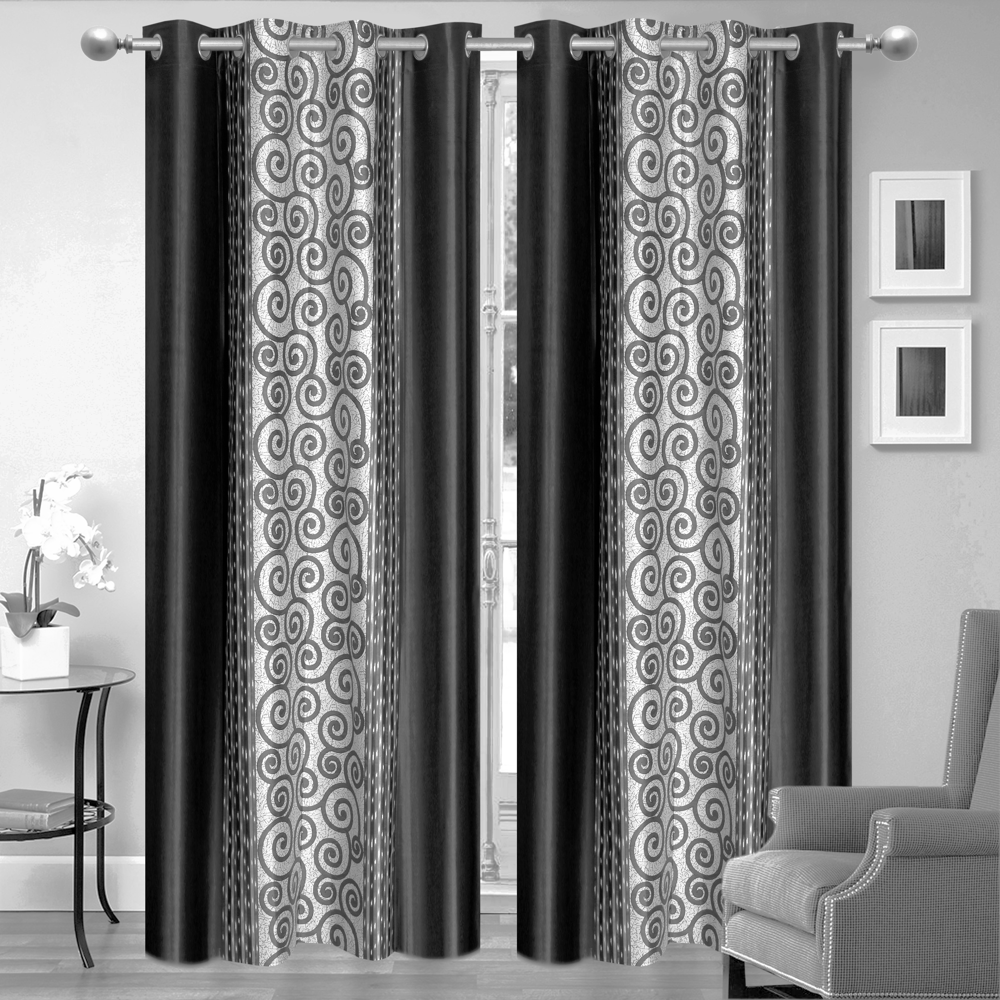

In [93]:
Image.fromarray(im_) 

# Exemple de prétraitement

## >>> Lecture d'une image + affichage

(<matplotlib.image.AxesImage at 0x15e2307ac10>,)

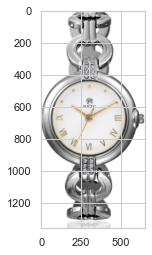

In [94]:
#img_2 = cv2.imread(img_test.iloc[3]['image'])
#RGB_im = cv2.cvtColor(img_2, cv2.COLOR_BGR2RGB)
img_2 = Image.open(file_path + data_mdl.iloc[777]['image'])
img_conv = np.array(img_2)
plt.imshow(img_2), 

## >>> Passage en grey scalede l'image + affichage

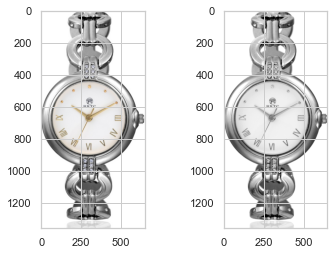

In [95]:
test = rgb_to_grey(img_conv)
display_two_images(img_conv, test)

## >>> Contrast + égalisation d'histogramme

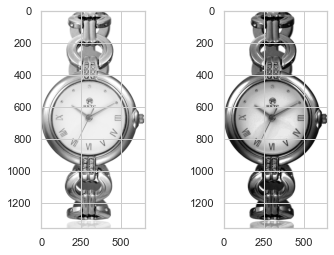

In [96]:
test1 = auto_contrst(test)
test2 = equalize_hist(test1)
display_two_images(test, test2)


## >>> Filtre Gaussian Blur

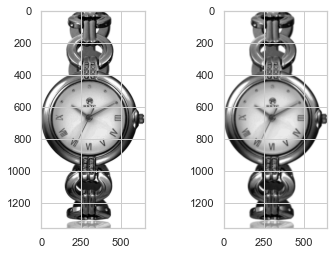

In [97]:

img44 = gaussianBlur(test2,2)
display_two_images(test2, img44)


In [98]:
type(img44)

PIL.Image.Image

## >>> Redimentionnement de l'image 224*224

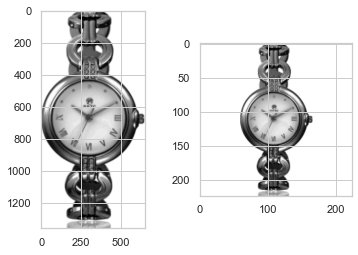

In [99]:
img5 = resize_to_Square(np.array(img44), 224,interpolation=Image.ANTIALIAS)
display_two_images(img44, img5)

In [100]:
path = "D:\\Projet Classrooms\\Projet_6\\"

## >>> Fonction intégrale de prétraitement

In [101]:
def pretraitement(df, k ):
    
    """ 
    Une fonction qui lit l'image et fait:
        * le passage en gris
        * De l'Auto contrast
        * L'égalisation de l'histogramme
        * Lissage pour eliminer le bruit
        * Resize en 224*224 
    puis enregister l'image dans un répertoire...
    
    """
    #dir_images_traitée = path + "Images_traitée"
    Images = []
    for img_name in df["image"]:
        
        img = Image.open(file_path + img_name) # Lecture de l'image
        
        # passer l'image en greyscale
        img = rgb_to_grey(img)
        
        # auto contrast
        img = auto_contrst(img)
        
        # égalisation d'histogramme
        img = equalize_hist(img)
        
        # Gaussian Blur
        img = gaussianBlur(img, k)
        
        # Redimmentionner l'image 224*224
        img = resize_to_Square(np.array(img), 224,interpolation=Image.ANTIALIAS)
    
        Images.append(img)
        #img = Image.fromarray(img) # Transforme un array en Image
        cv2.imwrite(str("D:\\Projet Classrooms\\Projet_6\\trans_img\\") + str(img_name), img)        
    return Images


In [102]:
Images_list = pretraitement(data_mdl, 2)

C:\Users\Win\anaconda3\lib\site-packages\PIL\Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


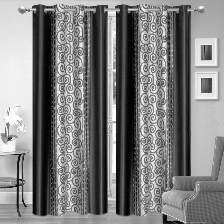

In [103]:
Image.fromarray(Images_list[0])

# Extraction de features ORB, SIFT ou SURF et transfer learning (CNN)
***
    * SIFT
 SIFT proposed by Lowe solves the image rotation, affine transformations, intensity, and viewpoint change in matching features. The SIFT algorithm has 4 basic steps. First is to estimate a scale space extrema using the Difference of Gaussian (DoG). Secondly, a key point localization where the key point candidates are localized and refined by eliminating the low contrast points. Thirdly, a key point orientation assignment based on local image gradient and lastly a descriptor generator to compute the local image descriptor for each key point based on image gradient magnitude and orientation.

    * SURF 
SURF approximates the DoG with box filters. Instead of Gaussian averaging the image, squares are used for approximation since the convolution with square is much faster if the integral image is used. Also this can be done in parallel for different scales. The SURF uses a BLOB detector which is based on the Hessian matrix to find the points of interest. For orientation assignment, it uses wavelet responses in both horizontal and vertical directions by applying adequate Gaussian weights. For feature description also SURF uses the wavelet responses. A neighborhood around the key point is selected and divided into subregions and then for each subregion the wavelet responses are taken and represented to get SURF feature descriptor. The sign of Laplacian which is already computed in the detection is used for underlying interest points. The sign of the Laplacian distinguishes bright blobs on dark backgrounds from the reverse case. In case of matching the features are compared only if they have same type of contrast (based on sign) which allows faster matching

    * ORB
 ORB is a fusion of the FAST key point detector and BRIEF descriptor with some modifications [9]. Initially to determine the key points, it uses FAST. Then a Harris corner measure is applied to find top N points. FAST does not compute the orientation and is rotation variant. It computes the intensity weighted centroid of the patch with located corner at center. The direction of the vector from this corner point to centroid gives the orientation. Moments are computed to improve the rotation invariance. The descriptor BRIEF poorly performs if there is an in-plane rotation. In ORB, a rotation matrix is computed using the orientation of patch and then the BRIEF descriptors are steered according to the orientation.


## 1. Extraction de features SIFT
    * (Scale-Invariant Feature Transform)

    La méthodoligie d'extraction de features par SIFT se fait en 4 étapes :

        * Récupérer les descripteurs de chaque image par un algorithme de type SIFT
        * Clusteriser l'ensemble de tous les descripteurs


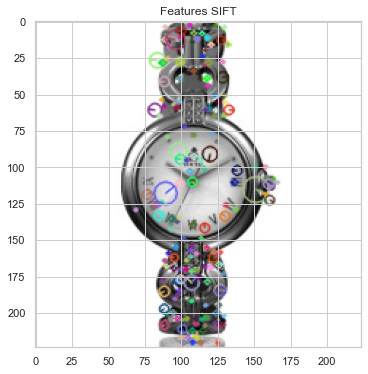

In [104]:
img_s = cv2.imread(("D:\\Projet Classrooms\\Projet_6\\trans_img\\") + data_mdl.iloc[777]['image'])

sift = cv2.SIFT_create()
kp = sift.detect(img_s,None)
img_s=cv2.drawKeypoints(img_s,kp,img_s, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
# Affichage
plt.figure(figsize=(6,6))
plt.title('Features SIFT')
plt.imshow(img_s)

## 1. Extraction de features ORB
    * ()

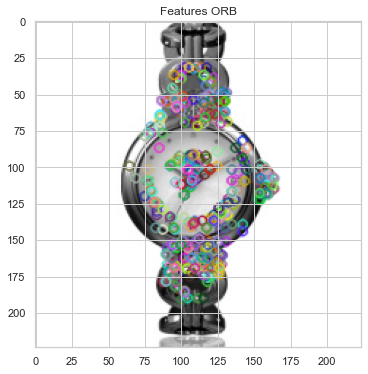

In [105]:
img_s = cv2.imread(("D:\\Projet Classrooms\\Projet_6\\trans_img\\") + data_mdl.iloc[777]['image'])

ORB = cv2.ORB_create()
kp = ORB.detect(img_s,None)
img_s=cv2.drawKeypoints(img_s,kp,img_s, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG)
# Affichage
plt.figure(figsize=(6,6))
plt.title('Features ORB')
plt.imshow(img_s, )

## 3. Extraction de featres SURF

In [106]:

img_s = cv2.imread(("D:\\Projet Classrooms\\Projet_6\\trans_img\\") + data_mdl.iloc[777]['image'])

SURF = cv2.xfeatures2d().SURF_create()
kp = SURF.detect(img_s,None)
img_s=cv2.drawKeypoints(img_s,kp,img_s, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG)
# Affichage
plt.figure(figsize=(6,6))
plt.title('Features ORB')
plt.imshow(img_s)

AttributeError: module 'cv2' has no attribute 'xfeatures2d'

In [107]:
def sift_kp_desc(gray_img):
    
    sift = cv2.SIFT_create()
    """
    la fonct sift_kp_desc revoie les keypoints et descripteurs d'une image
    desc is the SIFT descriptors, they're 128-dimensional vectors
    """
    keypoint, descriptor = sift.detectAndCompute(gray_img, None) #renvoie les keypoints et descripteurs d'une image
    return keypoint, descriptor
# les key point ce sont les features

In [108]:
categories = data_mdl["cat_1"]

In [109]:
from ipywidgets import IntProgress, Text

In [110]:
def extraction_features(ListOfImages):
    '''
    Extraction des features à partir des données
    '''
    max_count = len(ListOfImages)
    
    #affichage du compteur
    f = IntProgress(min=0, max=max_count) # instantiate the bar
    chaine = str(0)+'/'+str(max_count)
    g = Text(value=chaine)
    display(f) # display the bar
    display(g)
    
    liste_features = []
    liste_descripteurs = []
    liste_descripteurs_formates = []

    #boucle d'extraction des features de chaque image
    i = 0
    for array_image in ListOfImages:
        i+=1
        fea, des = sift_kp_desc(array_image)
      
        liste_features.append(fea)
        liste_descripteurs.append(des)
        
        f.value = i # signal to increment the progress bar
        g.value = str(i)+'/'+str(max_count)
    
    # détermination dimension maximum  du nombre de features par image
    nb_features_max = 0
    
    for descripteur in liste_descripteurs:
        if descripteur.shape[0] > nb_features_max:
            nb_features_max = descripteur.shape[0]
            
    # on transforme les array des descripteurs en vecteurs (PM : un descripteur = 128 pixels de large)
    liste_descripteurs_flatten = []
    for descripteur in liste_descripteurs:
        liste_descripteurs_flatten.append(descripteur.reshape(1,-1))   
    
    # harmonisation du nombre de features par image : ajout pixels noirs
    k = 0
    for descripteur in liste_descripteurs_flatten:
        if descripteur.shape[1] <= nb_features_max*128:
            # np.hstack : Empilez les tableaux en séquence horizontalement (par colonne).
            liste_descripteurs_formates.append(
                np.hstack([descripteur.reshape(1,-1), 
                           np.zeros(nb_features_max*128 - descripteur.shape[1]).reshape(1,-1)]))        
        else:
            liste_descripteurs_formates.append(descripteur)
            
    # assemblage_features
    # np.vstack : Empilez les tableaux en séquence verticalement (par rangée).
    array_descripteurs = np.vstack(liste_descripteurs_formates)
    
    del liste_descripteurs_formates, descripteur, max_count, ListOfImages
    
    
    return liste_features, liste_descripteurs, array_descripteurs

In [111]:
features_total, descripteurs_total, descripteurs_array = extraction_features(Images_list)


IntProgress(value=0, max=1050)

Text(value='0/1050')

In [112]:
descripteurs_total[0].shape

(359, 128)

In [113]:
len(features_total[0])

359

In [114]:
descripteurs_total[1].shape

(129, 128)

    * l'ensemble des descripteur (assemblage des features)

In [115]:
descripteurs_array.shape

(1050, 257024)

In [116]:
descripteurs_array

array([[ 0.,  0., 33., ...,  0.,  0.,  0.],
       [ 2.,  4., 26., ...,  0.,  0.,  0.],
       [ 8.,  0.,  0., ...,  0.,  0.,  0.],
       ...,
       [19.,  1.,  0., ...,  0.,  0.,  0.],
       [ 0.,  1., 24., ...,  0.,  0.,  0.],
       [ 1.,  1.,  1., ...,  0.,  0.,  0.]])

In [117]:
descripteurs_total[0].shape # descriteur par image

(359, 128)

(1050, 257024)


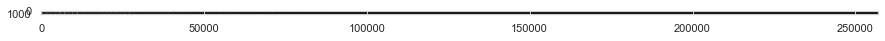

In [118]:
print(descripteurs_array.shape)
plt.figure(figsize = (15, 20))
plt.imshow(descripteurs_array, cmap = 'gray')

Maintenant, nous allons créer de nouvelles caractéristiques (features) à partir des descripteurs.

In [119]:
np.var(descripteurs_total[0])

1413.5742

In [120]:
from scipy.stats import moment
liste_min = [np.min(descripteur) for descripteur in descripteurs_total]
liste_max = [np.max(descripteur) for descripteur in descripteurs_total]
liste_mean = [np.mean(descripteur) for descripteur in descripteurs_total]
liste_var = [np.var(descripteur) for descripteur in descripteurs_total]
liste_order_3 = [np.mean(moment(descripteur, moment = 3, axis = 1)) for descripteur in descripteurs_total]
liste_order_4 = [np.mean(moment(descripteur, moment = 4, axis = 1)) for descripteur in descripteurs_total]

In [121]:
array_features_descripteurs = np.vstack([liste_min, liste_max, liste_mean, liste_var, liste_order_3, liste_order_4])

<Figure size 432x288 with 0 Axes>

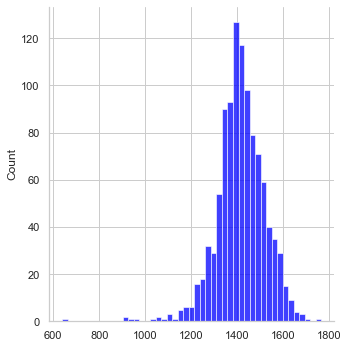

<Figure size 432x288 with 0 Axes>

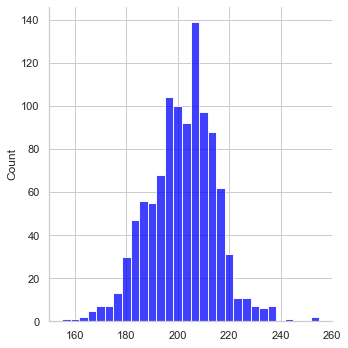

<Figure size 432x288 with 0 Axes>

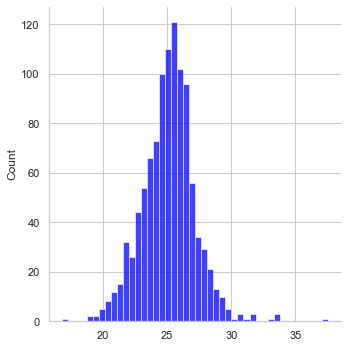

<Figure size 432x288 with 0 Axes>

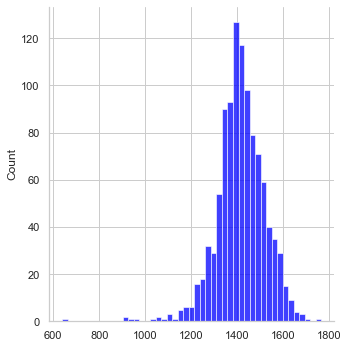

<Figure size 432x288 with 0 Axes>

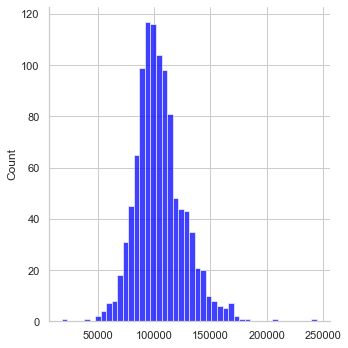

<Figure size 432x288 with 0 Axes>

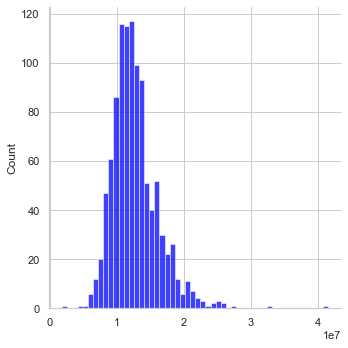

In [122]:
dict = {'Min'                  : liste_var, 
        'Max'                  : liste_max,
        'Mean'                 : liste_mean,
        'Var'                  : liste_var,
        'Mean Moment 3rd order': liste_order_3,
        'Mean Moment 4th order': liste_order_4}

for k,v in dict.items():
    plt.figure()
    sns.displot(v, color = 'blue').set_titles(k)


In [123]:
#Sauvegarde des nouvelles données
np.save('D:/Projet Classrooms/Projet_6/data_saved_array_descripteurs.csv', descripteurs_array)
np.save('D:/Projet Classrooms/Projet_6/data_saved_array_features_descripteurs', array_features_descripteurs)

# ACP

In [124]:
#PCA = PCA()
#SS = StandardScaler()
#PCA.fit(SS.fit_transform(np.transpose(descripteurs_array.T)))
desc_PCA_reduit, pca = PCA_features_reduction(descripteurs_array, var_threshold=0.95, verbose=True)

Initial number of features: 257024
Number of selected features: 411
Cumulative explained variance:  95.01%


In [125]:
#desc_PCA_reduit = PCA.transform(descripteurs_array[:777,:])

    * 95... % de la variance totale représente 777 features

In [126]:
desc_PCA_reduit

array([[ 1.16265684e+02,  8.91977408e+02, -1.96181934e+03, ...,
        -2.24119358e+02, -4.17264097e+01, -3.09297893e+02],
       [ 1.11852641e+01,  6.46733330e+01, -1.58424231e+02, ...,
        -1.70347503e+02, -2.41410696e+01, -9.94304972e+01],
       [ 2.67362958e+02,  2.02108801e+03, -3.87302814e+03, ...,
        -1.94678400e+00,  6.19408136e+01, -3.12586288e+01],
       ...,
       [ 2.25465627e+02,  1.73375391e+03, -3.45999107e+03, ...,
        -2.37622772e+01,  5.95226194e+01,  7.85695763e+00],
       [ 4.77128466e+00,  2.83841477e+01, -6.51708685e+01, ...,
        -3.79054948e+01,  8.24901775e+01,  1.40161254e+01],
       [ 4.29804966e+02,  3.01374533e+03, -5.14817053e+03, ...,
         4.09969387e+01,  9.55115485e+01, -8.87266382e+01]])

In [127]:
desc_PCA_reduit.shape

(1050, 411)

In [128]:
pca.n_components_

1050

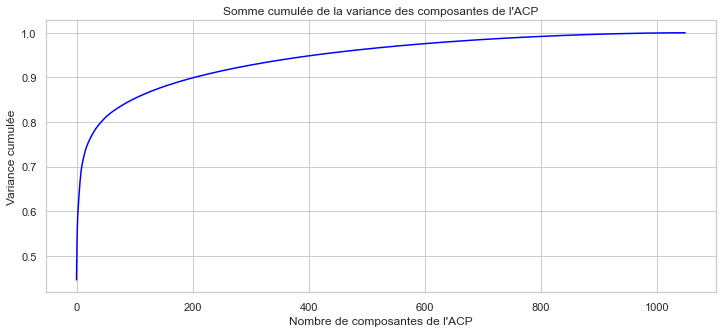

In [129]:
plt.figure(figsize=(12,5))
plt.title("Somme cumulée de la variance des composantes de l'ACP")
plt.xlabel("Nombre de composantes de l'ACP")
plt.ylabel('Variance cumulée')
plt.plot(list(range(descripteurs_array.shape[0])), np.cumsum(pca.explained_variance_ratio_), color='blue')

In [130]:
#Nous sauvegardons le fichier
np.save('desc_PCA_reduit.csv', desc_PCA_reduit)

# KMeans

In [131]:
dict_kmeans = {}
inertia = {}
max_clusters = 63

f = IntProgress(min = 0, max = max_clusters) #initialisation
chaine = str(0) + '/' + str(max_clusters)
g = Text(value = chaine)
display(f) #affichage
display(g)

for k in range(1, max_clusters + 1):
    kmeans = cluster.KMeans(n_clusters = k,
                   verbose = 0,
                   random_state = 0).fit(desc_PCA_reduit)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    
    
    f.value = k #affichage de l'avancement de l'incrémentation
    g.value =str(k+1) + '/' + str(max_clusters)

IntProgress(value=0, max=63)

Text(value='0/63')

C:\Users\Win\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


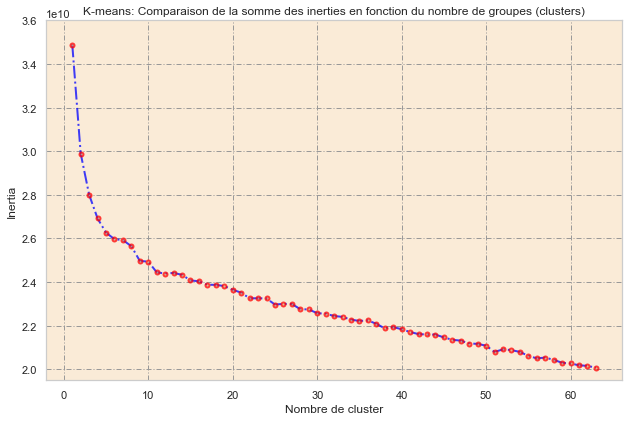

In [144]:
fig = plt.figure(figsize=(8,5))
axes = fig.add_axes([0,0,1,1])
axes.plot( list(inertia.keys()), list(inertia.values()), color = 'blue', alpha=.75, lw= 2, ls= '-.', marker= 'o',
          markersize=2, markerfacecolor='y', markeredgecolor='red', markeredgewidth=4 )

#axes.set_xlim([0,70])
axes.set_ylim([1.95*10000000000,3.6*10000000000])
axes.set_xlabel('Nombre de cluster')
axes.set_ylabel('Inertia')
axes.set_title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
#axes.axvline(5, color='green', ls='--')
axes.axhline(7, color='blue', ls='--')
axes.grid(True, color='0.6', dashes=(5,2,1,2))
axes.set_facecolor("#faebd7")

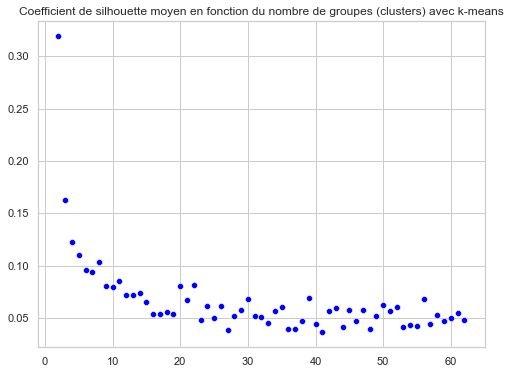

In [145]:
from sklearn.metrics import silhouette_score
silhouettes_kmeans = {}
for i in range(2,max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = desc_PCA_reduit, labels = list(dict_kmeans[i].labels_))

plt.figure(figsize = (8, 6)),
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes (clusters) avec k-means')
sns.scatterplot(x = list(silhouettes_kmeans.keys()),
                y = list(silhouettes_kmeans.values()),
                color='blue')
plt.show()

In [146]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('Le coefficient de silhouette est maximal pour {} groupes (score = {})'.format(key, value))
        nb_clusters = key

Le coefficient de silhouette est maximal pour 2 groupes (score = 0.3192656782116323)


In [147]:
pca.components_.shape

(1050, 257024)

In [148]:
dict_kmeans[10].cluster_centers_[1] 

array([ 1.23649723e+03,  6.55627585e+03, -6.17216836e+03,  1.94235383e+02,
        1.08601130e+02, -1.56109990e+02,  1.94111407e+02,  8.36037576e+02,
       -2.49331218e+03, -2.53666200e+03, -7.00106387e+02, -2.29825576e+03,
       -2.96952174e+03, -2.22228769e+03,  2.71982213e+03,  2.33538206e+03,
       -2.14798736e+03,  1.04525713e+03, -4.29644578e+02, -1.43546077e+02,
       -6.66825276e+02, -5.39061738e+02,  1.99989569e+02, -2.11836798e+02,
       -2.24092530e+02, -1.60951341e+02, -2.57276730e+02, -5.10600230e+02,
        4.51322276e+02,  6.95505364e+01,  6.74088926e+01,  1.17898796e+02,
       -1.14374559e+02, -6.88742777e+01, -5.43258036e+02,  8.02929041e+01,
        1.80661116e+01,  7.23696155e+01, -2.19267096e+02, -2.54775296e+02,
        3.98780323e+02, -1.32801901e+02, -1.50366750e+01, -8.98120217e+01,
        1.88652784e+02, -3.46009679e+02,  5.82086505e+01, -2.56510378e+01,
       -7.42120251e+01, -4.09004511e+02,  6.57017835e+02, -7.28091962e+02,
       -4.26907499e+02, -

Visualisation d'un visual word

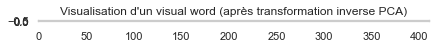

In [149]:
plt.figure(figsize = (7, 10))
plt.title("Visualisation d'un visual word (après transformation inverse PCA)")
plt.imshow(np.dot(dict_kmeans[25].cluster_centers_[4], pca.components_[:, :411].shape[1]).reshape(1,-1))

In [150]:
len_cat_2 = list(set(data_mdl['cat_2']))
len(len_cat_2)

63

In [151]:
y_cat_2_num = [(1-len_cat_2.index(data_mdl.iloc[i]['cat_2'])) for i in range(len(data_mdl))]

In [152]:
len(y_cat_2_num)

1050

In [162]:
import time

# Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et n° de clusters

def ARI_fct_2(features) :
    time1 = time.time()
    num_labels=len(len_cat_2)
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne_2 = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne_2)
    
    ARI = np.round(metrics.adjusted_rand_score(y_cat_2_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print('-'*100)
    print("ARI : ", ARI, "time : ", time2)
    print('-'*100)
    return ARI, X_tsne_2, cls.labels_

In [167]:
# visualisation du Tsne selon les vraies catégories et selon les clusters

def TSNE_visu_fct_2(X_tsne_2, y_cat_2_num, labels_2, ARI_2) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne_2[:,0],X_tsne_2[:,1], c=y_cat_2_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0],labels=len_cat_2, loc="best", title="Categorie_2")
    plt.title('Représentation des catégories réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne_2[:,0],X_tsne_2[:,1], c=labels_2, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels_2), loc="best", title="Clusters")
    plt.title('Représentation des clusters')
    plt.show()
    print("ARI : ", ARI_2)

# TSNE +  KMeans

----------------------------------------------------------------------------------------------------
array_descripteurs_reduit 
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
ARI :  0.0184 time :  19.0
----------------------------------------------------------------------------------------------------


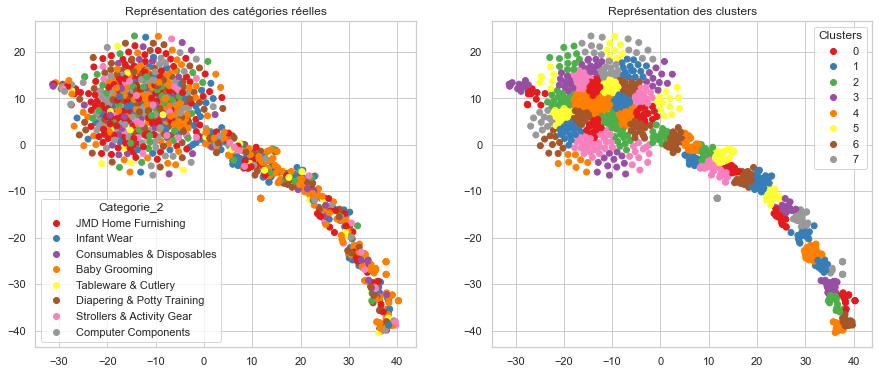

ARI :  0.0184


In [168]:
print("-"*100)
print("array_descripteurs_reduit ")
print("-"*100)
ARI_2, X_tsne_2, labels_2 = ARI_fct_2(desc_PCA_reduit)
TSNE_visu_fct_2(X_tsne_2, y_cat_2_num, labels_2, ARI_2)

    * Ce score est mauvais, la méthode n'est donc pas exploitable dans ce cas.

In [169]:
labels_2

array([53,  1, 58, ..., 49, 29,  5])

## 2. Transfert learning , CNN
    * (CONVOLUTIONAL NEURAL NETWORK)

In [170]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(data_img, test_size = 0.25, random_state=42)

In [171]:
train.shape, test.shape

((787, 10), (263, 10))

In [172]:
train_cnn = get_files(train.copy()['image'].tolist())
test_cnn = get_files(test.copy()['image'].tolist())

C:\Users\Win\anaconda3\lib\site-packages\PIL\Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [173]:
redim(train_cnn[0], 128, 128).shape

(128, 128, 3)

In [174]:
redim(train_cnn[0], 128, 128).reshape(1,-1,3).shape


(1, 16384, 3)

In [175]:
train_array_cnn = np.vstack([redim(img, 128, 128).reshape(1,128,128,3) for img in train_cnn])
test_array_cnn  = np.vstack([redim(img, 128, 128).reshape(1,128,128,3) for img in  test_cnn])

In [176]:
train_array_cnn.shape

(787, 128, 128, 3)

In [177]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(handle_unknown='ignore')
array_cats = ohe.fit_transform(np.array(train['cat_2']).reshape(-1,1))

In [178]:
array_cats.todense().shape

(787, 58)

In [179]:
train_array_cats = ohe.transform(train[['cat_2']]).todense()
test_array_cats = ohe.transform(test[['cat_2']]).todense()

C:\Users\Win\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(
C:\Users\Win\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(


In [180]:
ohe.categories_

[array(['Baby & Kids Gifts', 'Baby Bath & Skin', 'Baby Bedding',
        'Baby Grooming', 'Bar & Glassware', 'Bath Linen', 'Bath and Spa',
        'Bed Linen', 'Body and Skin Care', 'Candles & Fragrances',
        'Clocks', 'Coffee Mugs', 'Combos and Kits', 'Computer Components',
        'Computer Peripherals', 'Containers & Bottles', 'Cookware',
        'Curtains & Accessories', 'Cushions, Pillows & Covers',
        'Decorative Lighting & Lamps', 'Diapering & Potty Training',
        'Dinnerware & Crockery', 'Eye Care', 'Feeding & Nursing',
        'Floor Coverings', 'Flowers, Plants & Vases', 'Fragrances',
        'Furniture & Furnishings', 'Garden & Leisure', 'Hair Care',
        'Health Care', 'Housekeeping & Laundry', 'Infant Wear',
        'Kitchen & Dining Linen', 'Kitchen Tools',
        "Kripa's Home Furnishing", 'Laptop Accessories', 'Laptops',
        'Lighting', 'Living', 'Living Room Furnishing', 'Living"]',
        'Makeup', 'Network Components', 'Pressure Cookers & Pans'

## Construction du réseau

In [181]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input

from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Flatten, Dense, Activation

from keras.models import clone_model

import sys

from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16


In [182]:
model = Sequential()
model.add(Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu', input_shape = (128, 128, 3)))
model.add(MaxPooling2D(pool_size = (2, 2)))
model.add(Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu'))
model.add(MaxPooling2D(pool_size = (2, 2)))
model.add(Flatten())
model.add(Dense(ohe.categories_[0].shape[0], activation = 'softmax'))
model.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [183]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 58)                1

## Entrainement du modele

In [184]:
train_array_cnn.shape

(787, 128, 128, 3)

In [185]:
model_info = model.fit(train_array_cnn, train_array_cats, epochs = 3, batch_size = 40, verbose = 2)

Epoch 1/3
20/20 - 6s - loss: 0.0341 - 6s/epoch - 322ms/step
Epoch 2/3
20/20 - 6s - loss: 0.0343 - 6s/epoch - 282ms/step
Epoch 3/3
20/20 - 6s - loss: 0.0343 - 6s/epoch - 284ms/step


In [186]:
for couche in model.get_weights():
    print(couche.shape)

(3, 3, 3, 32)
(32,)
(3, 3, 32, 32)
(32,)
(32768, 58)
(58,)


In [187]:
predictions_test = model.predict(test_array_cnn)

9/9 [==============================] - 1s 63ms/step


In [188]:
accuracy_score(np.argmax(predictions_test, axis=1).reshape(-1,1),
               np.argmax(test_array_cats, axis=1).reshape(-1,1))

0.011406844106463879

In [189]:
np.argmax(test_array_cats, axis = 1).reshape(1, -1)

matrix([[43, 38, 36, 26, 57, 32, 47, 14,  7,  7, 57,  1, 11,  6, 52, 36,
         32, 36,  5, 17, 16, 36, 32, 36, 57, 12, 19,  0, 26, 11, 11, 43,
         36, 57, 51,  7, 57, 47, 47, 43, 18, 42, 38, 17, 42, 34, 16, 49,
          0,  7, 11, 47, 15, 41, 43, 32, 29, 34, 52, 39,  5,  0, 57, 16,
         57,  5,  0, 19,  7, 57, 32, 36, 43, 36, 57, 43,  7, 47, 36,  7,
         33,  5, 43, 34, 43, 57, 24, 19, 47, 51, 40,  7, 11, 47, 57, 36,
         32, 57, 47, 32,  0, 57, 55, 40, 36, 57,  6, 15,  7, 36, 34,  7,
          7, 32,  1, 23, 36, 57, 57, 36, 43, 36, 55,  5, 11, 19, 12, 47,
         23,  1, 16, 42,  0, 47,  3, 11, 51, 12, 11, 36, 11,  2, 47, 33,
         17, 57, 57, 26, 51,  0, 57, 26, 57, 55, 43,  5, 57,  8, 55, 57,
         57, 57,  1, 36, 47, 57, 57, 43, 57, 36, 57, 26, 17, 57, 32, 57,
         47, 47,  7, 47, 32, 11, 17, 55, 32, 26, 27, 57, 36, 18, 26, 57,
         15, 17, 11, 14, 26, 16, 43, 43, 26, 32, 33, 43, 26, 55, 57, 32,
         20, 47, 57, 51, 36, 36, 17, 12, 32,  7, 47

In [190]:
np.argmax(predictions_test, axis = 1)

array([23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23, 23,
       23, 23, 23, 23, 23

In [191]:
ohe.categories_[0][25]

'Flowers, Plants & Vases'

## Classification non supervisée

    * élimination les deux derniéres couches du réseau de neurones.

In [192]:
unsupervised_model = clone_model(model)
unsupervised_model.layers.pop()
unsupervised_model.layers.pop()
unsupervised_model.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [193]:
unsupervised_array = unsupervised_model.predict(train_array_cnn)

25/25 [==============================] - 1s 49ms/step


In [194]:
unsupervised_array.shape

(787, 58)

In [195]:
dict_kmeans = {}
inertia = {}
max_clusters = 63

f = IntProgress(min = 0, max = max_clusters) #initialisation
chaine = str(0) + '/' + str(max_clusters)
g = Text(value = chaine)
display(f) #affichage
display(g)

for k in range(1, max_clusters + 1):
    kmeans = cluster.KMeans(n_clusters = k,
                   verbose = 0,
                   random_state = 0).fit(unsupervised_array)
    inertia[k] = kmeans.inertia_
    dict_kmeans[k] = kmeans
    f.value = k #affichage de l'avancement de l'incrémentation
    g.value = str(k+1) + '/' + str(max_clusters)

IntProgress(value=0, max=63)

Text(value='0/63')

C:\Users\Win\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


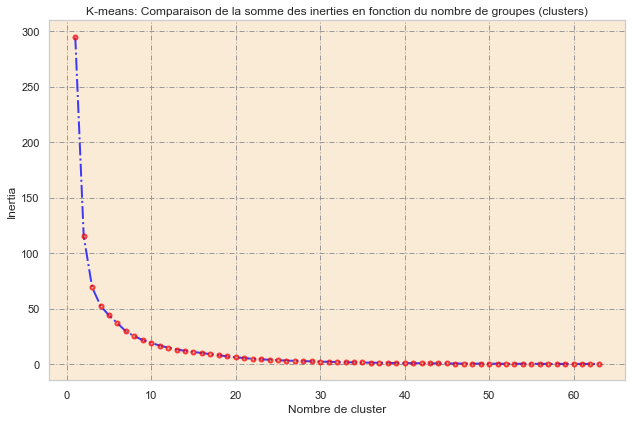

In [196]:
fig = plt.figure(figsize=(8,5))
axes = fig.add_axes([0,0,1,1])
axes.plot( list(inertia.keys()), list(inertia.values()), color = 'blue', alpha=.75, lw= 2, ls= '-.', marker= 'o',
          markersize=2, markerfacecolor='y', markeredgecolor='red', markeredgewidth=4 )

#axes.set_xlim([0,70])
#axes.set_ylim([1.95*10000000000,3.6*10000000000])
axes.set_xlabel('Nombre de cluster')
axes.set_ylabel('Inertia')
axes.set_title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
#axes.axvline(5, color='green', ls='--')
#axes.axhline(7, color='blue', ls='--')
axes.grid(True, color='0.6', dashes=(5,2,1,2))
axes.set_facecolor("#faebd7")

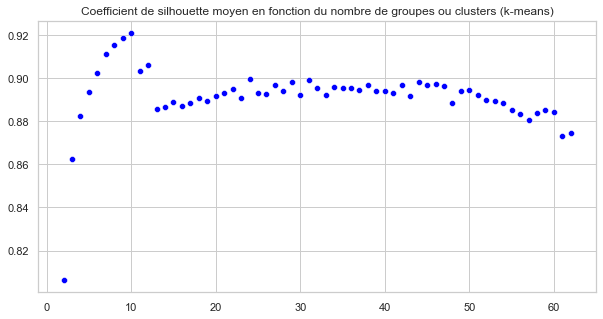

In [197]:
silhouettes_kmeans = {}
for i in range(2,max_clusters):
    silhouettes_kmeans[i] = silhouette_score(X = unsupervised_array, labels = list(dict_kmeans[i].labels_))

plt.figure(figsize = (10, 5))
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes ou clusters (k-means)')
sns.scatterplot(x = list(silhouettes_kmeans.keys()), y = list(silhouettes_kmeans.values()),
               color='blue')
plt.show()

In [214]:
for key, value in silhouettes_kmeans.items():
    if value == max(silhouettes_kmeans.values()):
        print('Le coefficient de silhouette est maximal pour {} clusters (score = {})'.format(key, value))
        nb_clusters_optimal = key

Le coefficient de silhouette est maximal pour 10 clusters (score = 0.9208968877792358)


In [236]:
dict_kmeans

{1: KMeans(n_clusters=1, random_state=0),
 2: KMeans(n_clusters=2, random_state=0),
 3: KMeans(n_clusters=3, random_state=0),
 4: KMeans(n_clusters=4, random_state=0),
 5: KMeans(n_clusters=5, random_state=0),
 6: KMeans(n_clusters=6, random_state=0),
 7: KMeans(n_clusters=7, random_state=0),
 8: KMeans(random_state=0),
 9: KMeans(n_clusters=9, random_state=0),
 10: KMeans(n_clusters=10, random_state=0),
 11: KMeans(n_clusters=11, random_state=0),
 12: KMeans(n_clusters=12, random_state=0),
 13: KMeans(n_clusters=13, random_state=0),
 14: KMeans(n_clusters=14, random_state=0),
 15: KMeans(n_clusters=15, random_state=0),
 16: KMeans(n_clusters=16, random_state=0),
 17: KMeans(n_clusters=17, random_state=0),
 18: KMeans(n_clusters=18, random_state=0),
 19: KMeans(n_clusters=19, random_state=0),
 20: KMeans(n_clusters=20, random_state=0),
 21: KMeans(n_clusters=21, random_state=0),
 22: KMeans(n_clusters=22, random_state=0),
 23: KMeans(n_clusters=23, random_state=0),
 24: KMeans(n_cluste

    * le nombre d'éléments par catégorie.

In [237]:
pd.DataFrame(dict_kmeans[11].labels_)[0].value_counts()

0     199
1     165
4     140
2     131
7      61
6      23
5      22
8      18
3      12
9       8
10      8
Name: 0, dtype: int64

In [200]:
train_labelized = train.copy()
train_labelized['label_kmeans'] = dict_kmeans[nb_clusters_optimal].labels_

In [201]:
train_labelized.groupby(['label_kmeans']).apply(lambda x: (x.groupby('cat_2').count().sort_values('cat_2', ascending = False)))['uniq_id']

label_kmeans  cat_2                     
0             Wrist Watches                 62
              Women's Hygiene                1
              Wall Decor & Clocks           12
              Tidy Home Furnishing           1
              Tableware & Cutlery            3
                                            ..
9             Wrist Watches                  1
              Wall Decor & Clocks            1
              Laptop Accessories             1
              Diapering & Potty Training     1
              Coffee Mugs                    1
Name: uniq_id, Length: 131, dtype: int64

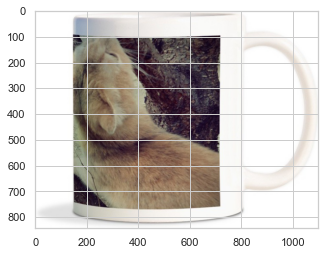

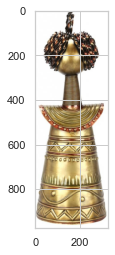

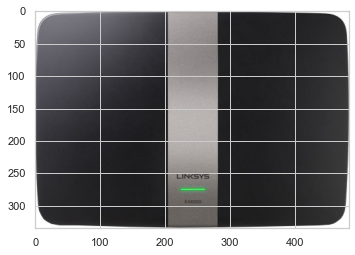

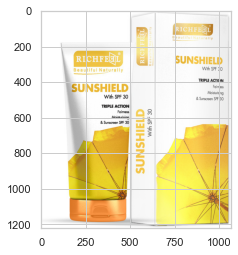

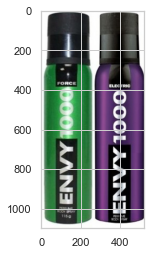

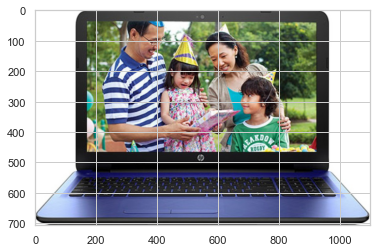

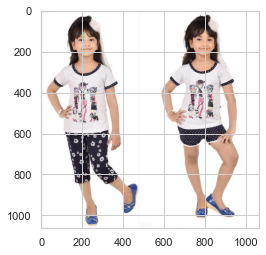

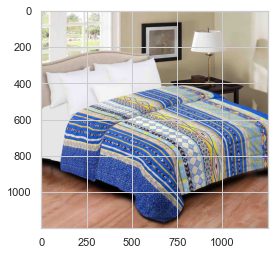

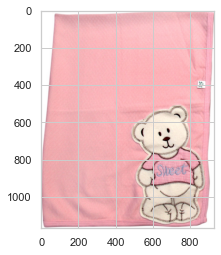

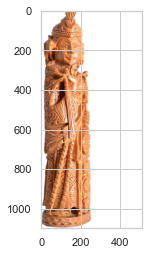

In [202]:
k = 0
for image in train_labelized[train_labelized['label_kmeans'] == 0]['image'].tolist():
    if k < 10:
        chemin = image
        plt.figure()
        plt.imshow(Image.open(chemin))
        plt.show()
        k += 1
    else:
        break

Vérifions la mémoire utilisée pour l'ensemble de ce calcul.

    * la préparation des données.

In [203]:
train.head(2)

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
165,785b4383b12106dd172306d427d8f7b2,Rockmantra Cute Two Cats Ceramic Mug,349.0,D:\Projet Classrooms\Projet_6\Images\785b4383b...,Rockmantra Cute Two Cats Ceramic Mug (5.5 l)\r...,Kitchen & Dining,Coffee Mugs,rockmantra cute two cats ceramic mug price giv...,rockmantra cute two cat ceramic mug price give...,rockmantra cute two cats ceramic mug ( 5.5 l )...
248,45d0af2c709de47268c80c35a117de44,Malhar Niko Male Doll Showpiece - 25 cm,5436.0,D:\Projet Classrooms\Projet_6\Images\45d0af2c7...,Buy Malhar Niko Male Doll Showpiece - 25 cm ...,Home Decor & Festive Needs,Showpieces,buy malhar niko male doll showpiece online mal...,buy malhar niko male doll showpiece online mal...,buy malhar niko male doll showpiece - 25 cm fo...


In [204]:
test.head(2)

,uniq_id,product_name,discounted_price,image,description,cat_1,cat_2,sentence_bow,sentence_bow_lem,sentence_dl
352,833a87b0af3b84fe246d2ebf271af177,Zyxel PLA-4205,8100.0,D:\Projet Classrooms\Projet_6\Images\833a87b0a...,Buy Zyxel PLA-4205 only for Rs. 8100 from Flip...,Computers,Network Components,buy zyxel pla flipkart com only genuine produc...,buy zyxel pla flipkart com only genuine produc...,buy zyxel pla-4205 only for rs . 8100 from fli...
689,55195de3873fffaa9e37b041533d7305,Philips 9.5 W LED B22 3000K A55 IND Bulb,419.0,D:\Projet Classrooms\Projet_6\Images\55195de38...,Buy Philips 9.5 W LED B22 3000K A55 IND Bulb f...,Kitchen & Dining,Lighting,buy philips led ind bulb online philips led in...,buy philip led ind bulb online philip led ind ...,buy philips 9.5 w led b22 3000k a55 ind bulb f...


In [205]:
len(train_cnn), len(test_array_cnn)

(787, 263)

In [206]:
if False:
    
    train_cnn = get_files(train.copy()['image'].tolist())
    test_cnn = get_files(test.copy()['image'].tolist())

    train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
    test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])
    del train_cnn,test_cnn
    #sauvegarde de train_array_ccn / test_array_cnn
    np.save('data_saved_train_images_array', train_array_cnn)
    np.save('data_saved_test_images_array', test_array_cnn)
#else :
 #   train_array_cnn = np.load('data_saved_train_images_array.npy')
  #  test_array_cnn = np.load('data_saved_test_images_array.npy')

In [207]:
ohe = OneHotEncoder(handle_unknown = 'ignore')
array_cats = ohe.fit_transform(np.array(train['cat_2']).reshape(-1,1))

In [208]:
array_cats.todense().shape

(787, 58)

In [209]:
train_array_cats = ohe.transform(train[['cat_2']]).todense()
test_array_cats = ohe.transform(test[['cat_2']]).todense()

C:\Users\Win\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(
C:\Users\Win\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but OneHotEncoder was fitted without feature names
  warnings.warn(


In [210]:
train_array_cats.shape, test_array_cats.shape, 

((787, 58), (263, 58))

In [211]:
ohe.categories_[0].shape[0]

58

## Transfer learning

        * Utilisation de VGG16

In [212]:
vgg = VGG16()
vgg.layers.pop()
vgg.layers.pop()

vgg_transfer = Sequential()
vgg_transfer.add(vgg)
vgg_transfer.trainable = False
vgg_transfer.add(Dense(ohe.categories_[0].shape[0], activation = 'softmax'))
vgg_transfer.compile(loss = 'mean_squared_error', optimizer = 'sgd')

In [213]:
train_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in train_cnn])
test_array_cnn = np.vstack([redim(img, 224, 224).reshape(1,224,224,3) for img in test_cnn])

print('train array shape : ', train_array_cnn.shape)
print('train array cats : ', train_array_cats.shape)

train array shape :  (787, 224, 224, 3)
train array cats :  (787, 58)


In [252]:
vgg_transfer.fit(train_array_cnn, train_array_cats, epochs = 3, batch_size = 20, verbose = 1)

Epoch 1/3
40/40 [==============================] - 157s 4s/step - loss: 0.0169
Epoch 2/3
40/40 [==============================] - 167s 4s/step - loss: 0.0169
Epoch 3/3
40/40 [==============================] - 171s 4s/step - loss: 0.0169


In [253]:
vgg_transfer.save_weights('models/weighs_vgg_transfer.weights')

In [254]:
vgg_transfer.load_weights('models/weighs_vgg_transfer.weights')

In [255]:
train.iloc[36]

uniq_id                              601817defaff9d0e30e1b72f96d3975f
product_name          CHINMAY KIDS Printed Cotton Padded Mosquito Net
discounted_price                                                540.0
image               D:\Projet Classrooms\Projet_6\Images\601817def...
description         Specifications of CHINMAY KIDS Printed Cotton ...
cat_1                                                       Baby Care
cat_2                                                    Baby Bedding
sentence_bow        specifications chinmay kids printed cotton pad...
sentence_bow_lem    specification chinmay kid printed cotton padde...
sentence_dl         specifications of chinmay kids printed cotton ...
Name: 82, dtype: object

1/1 [==============================] - 0s 480ms/step


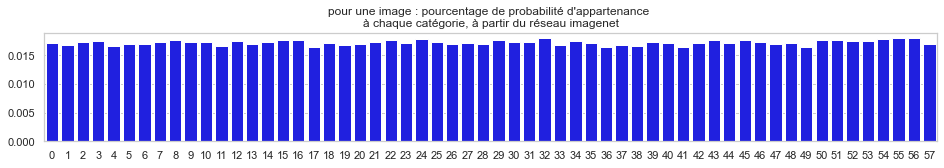

1/1 [==============================] - 0s 276ms/step


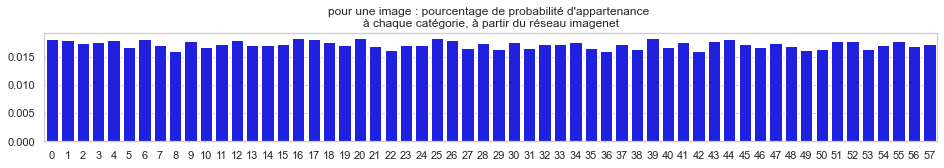

1/1 [==============================] - 0s 259ms/step


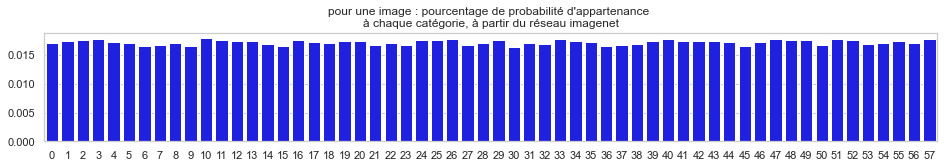

In [256]:
ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[24], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0], color = 'blue')
plt.show()

ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[28], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0], color = 'blue')
plt.show()

ex_prediction_vgg = vgg_transfer.predict(redim(test_array_cnn[36], 224, 224).reshape(1,224,224,3))
plt.figure(figsize = (16, 2))
plt.title("pour une image : pourcentage de probabilité d'appartenance \nà chaque catégorie, à partir du réseau imagenet")
sns.barplot(x = list(range(ex_prediction_vgg.shape[1])), y = ex_prediction_vgg[0], color = 'blue')
plt.show()

In [257]:
vgg_train_output = vgg_transfer.predict(train_array_cnn)
vgg_test_output = vgg_transfer.predict(test_array_cnn)

9/9 [==============================] - 47s 5s/step


In [258]:
vgg_train_output.shape

(787, 58)

In [259]:
vgg_test_output.shape

(263, 58)

In [260]:
vgg_output = np.vstack([vgg_train_output, vgg_test_output])

In [216]:
#**********************************************

In [261]:
vgg_output.shape

(1050, 58)

In [262]:
np.save('D:/Projet Classrooms/Projet_6/data_saved_transfer_learning_output', vgg_output)

## Approches combinées

In [263]:
X_NLP = np.load('D:/Projet Classrooms/Projet_6/data_saved_txt_PCA_reduit_NLP.csv.npy')
X_descripteurs = np.load('D:/Projet Classrooms/Projet_6/data_saved_array_features_descripteurs.npy')
X_CNN = np.load('D:/Projet Classrooms/Projet_6/data_saved_transfer_learning_output.npy')

In [264]:
X_NLP.shape

(1050, 547)

In [265]:
np.array(data_mdl['discounted_price']).reshape(-1,1).shape[1]

1

## Homogénisation des dimensions

In [266]:
print('NLP          : ', X_NLP.shape)
print('Descripteurs : ', X_descripteurs.T.shape)
print('CNN          : ', X_CNN.shape)

NLP          :  (1050, 547)
Descripteurs :  (1050, 6)
CNN          :  (1050, 58)


In [267]:
X_combined = np.hstack([np.array(data_mdl['discounted_price']).reshape(-1,1), X_NLP, X_CNN, X_descripteurs.T])

In [268]:
X_combined.shape

(1050, 612)

In [269]:
np.nan_to_num(X_combined, 0)

array([[ 8.99000000e+02,  1.99412553e+00, -4.01819702e-01, ...,
         1.41357422e+03,  1.02657352e+05,  1.18956750e+07],
       [ 4.49000000e+02,  1.05539120e+00, -2.51839215e-02, ...,
         1.49504663e+03,  1.25693023e+05,  1.62046870e+07],
       [ 0.00000000e+00,  2.50051288e+00, -5.61679854e-01, ...,
         1.46967554e+03,  1.17791156e+05,  1.44821440e+07],
       ...,
       [ 1.44900000e+03, -1.08313461e-01,  4.89905823e-02, ...,
         1.32682947e+03,  8.55308750e+04,  9.88633900e+06],
       [ 1.33300000e+03, -1.24838066e-01, -2.12616351e-02, ...,
         1.56090247e+03,  1.34215312e+05,  1.69233720e+07],
       [ 5.95000000e+02, -1.07513846e-01,  4.50684977e-02, ...,
         1.27406116e+03,  7.79161406e+04,  8.59414300e+06]])

In [270]:
np.save('D:/Projet Classrooms/Projet_6/data_saved_X_combined', X_combined)

In [271]:
X_combined = np.load('D:/Projet Classrooms/Projet_6/data_saved_X_combined.npy')

## Clustering

In [272]:
dict_kmeans_ = {}
inertia_ = {}
max_clusters = 63

f = IntProgress(min = 0, max = max_clusters) #initialisation
g = Text(value = '')
display(f) #affichage
display(g)

for k in range(1,max_clusters + 1):
    kmeans = cluster.KMeans(n_clusters = k, verbose = 0, random_state = 0).fit(X_combined)
    inertia_[k] = kmeans.inertia_
    dict_kmeans_[k] = kmeans
    
    f.value = k #incrémentation
    g.value =str(k) + '/' + str(max_clusters)

IntProgress(value=0, max=63)

Text(value='')

C:\Users\Win\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


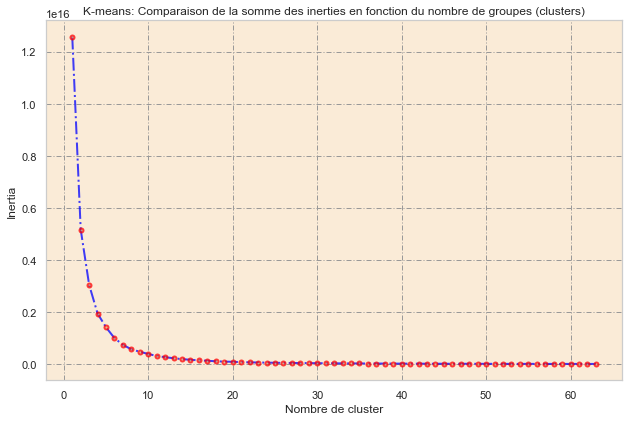

In [273]:
fig = plt.figure(figsize=(8,5))
axes = fig.add_axes([0,0,1,1])
axes.plot( list(inertia_.keys()), list(inertia_.values()), color = 'blue', alpha=.75, lw= 2, ls= '-.', marker= 'o',
          markersize=2, markerfacecolor='y', markeredgecolor='red', markeredgewidth=4 )

#axes.set_xlim([0,70])
#axes.set_ylim([1.95*10000000000,3.6*10000000000])
axes.set_xlabel('Nombre de cluster')
axes.set_ylabel('Inertia')
axes.set_title('K-means: Comparaison de la somme des inerties en fonction du nombre de groupes (clusters)')
#axes.axvline(5, color='green', ls='--')
#axes.axhline(7, color='blue', ls='--')
axes.grid(True, color='0.6', dashes=(5,2,1,2))
axes.set_facecolor("#faebd7")

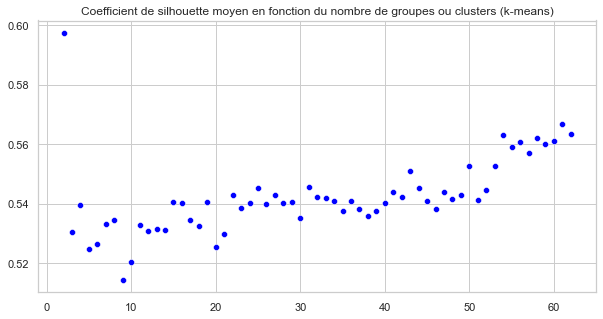

In [274]:
silhouettes_kmeans_ = {}
for i in range(2,max_clusters):
    silhouettes_kmeans_[i] = silhouette_score(X = X_combined, labels = list(dict_kmeans_[i].labels_))

plt.figure(figsize = (10, 5))
plt.title('Coefficient de silhouette moyen en fonction du nombre de groupes ou clusters (k-means)')
sns.scatterplot(x = list(silhouettes_kmeans_.keys()), y = list(silhouettes_kmeans_.values()),
               color='blue')
plt.show()

In [275]:
for key, value in silhouettes_kmeans_.items():
    if value == max(silhouettes_kmeans_.values()):
        print('Le coefficient de silhouette est maximal pour {} groupes (clusters) \n(score = {})'.format(key, value))
        nb_clusters = key

Le coefficient de silhouette est maximal pour 2 groupes (clusters) 
(score = 0.5973807956513321)


C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


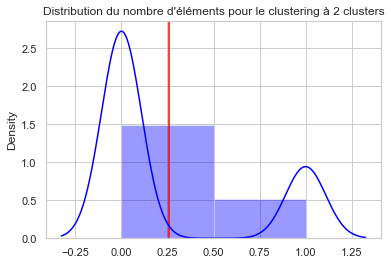

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


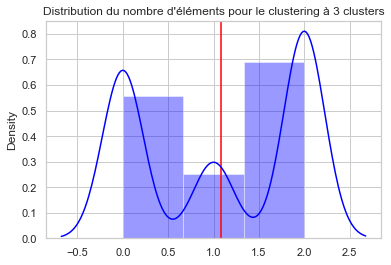

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


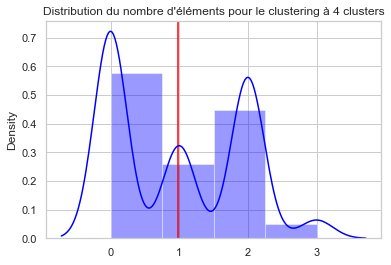

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


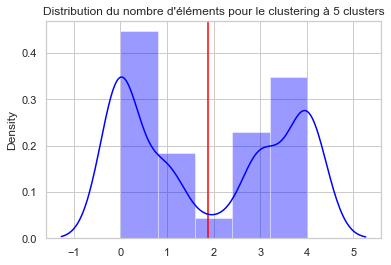

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


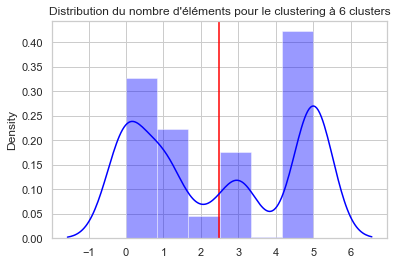

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


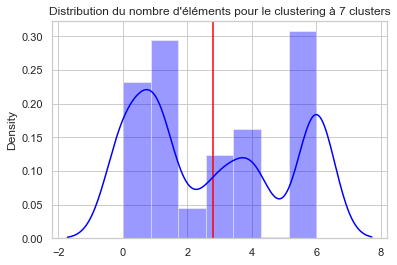

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


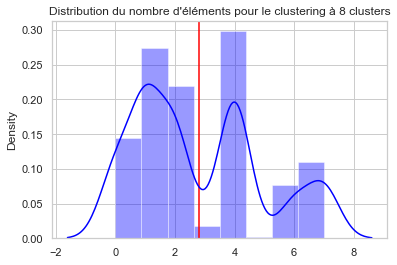

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


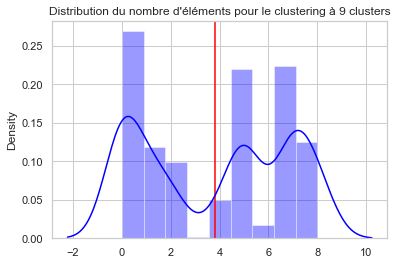

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


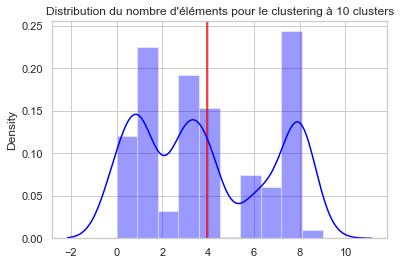

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


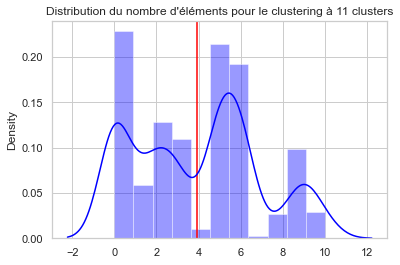

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


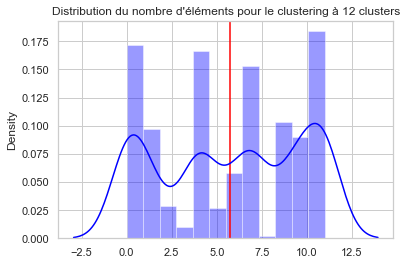

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


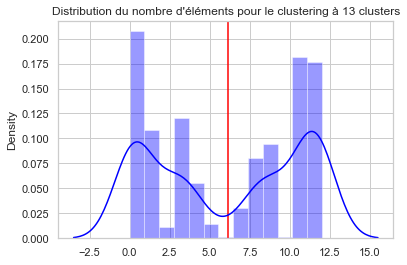

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


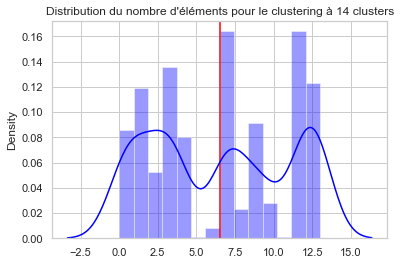

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


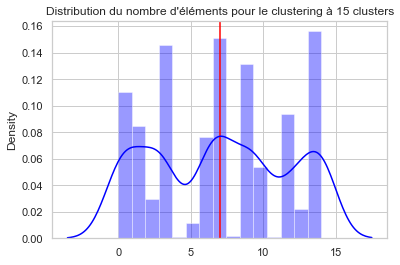

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


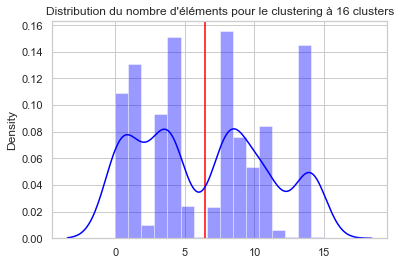

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


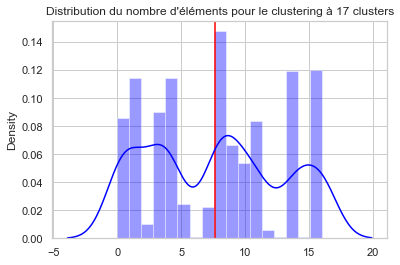

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


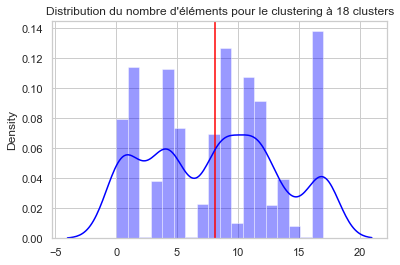

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


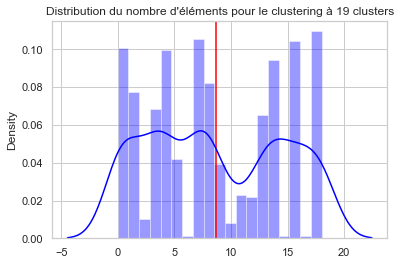

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


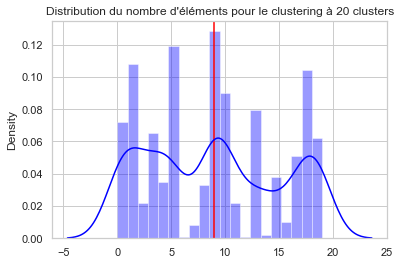

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


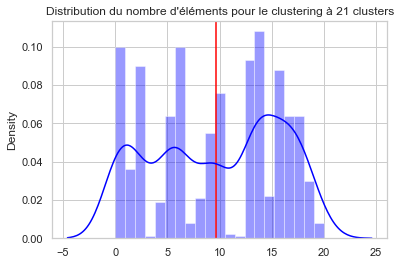

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


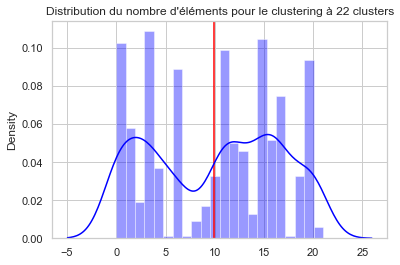

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


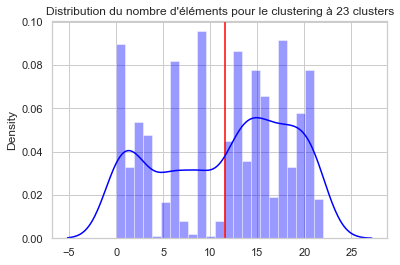

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


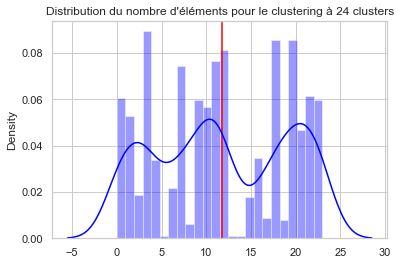

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


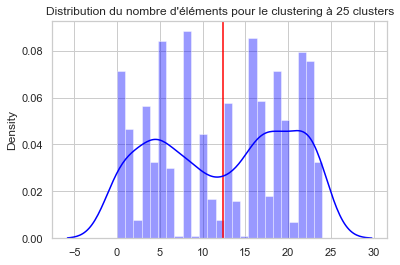

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


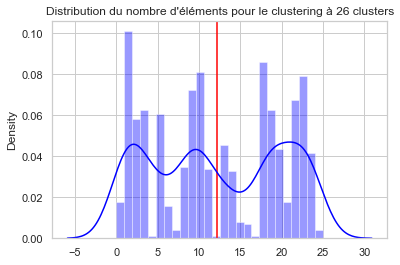

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


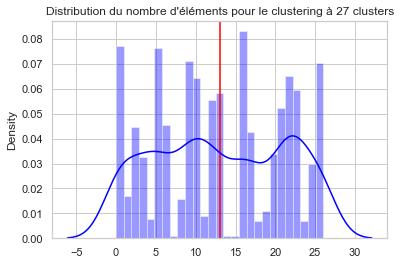

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


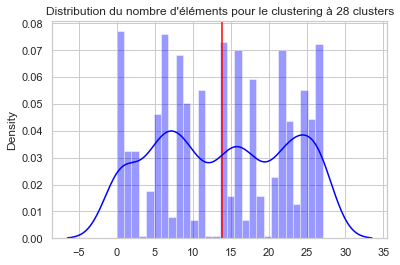

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


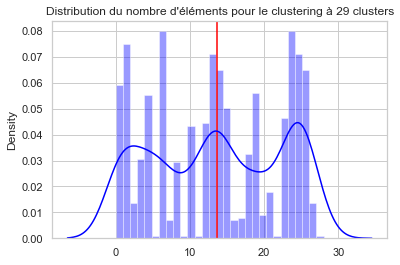

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


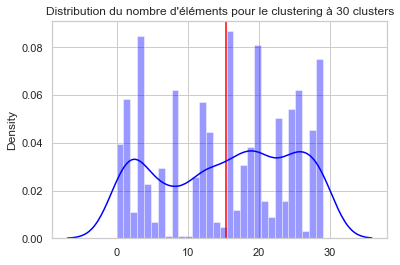

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


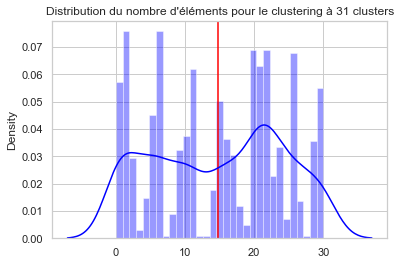

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


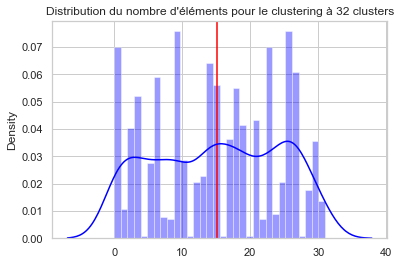

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


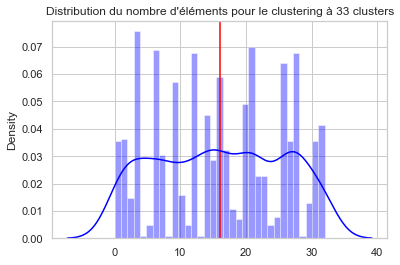

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


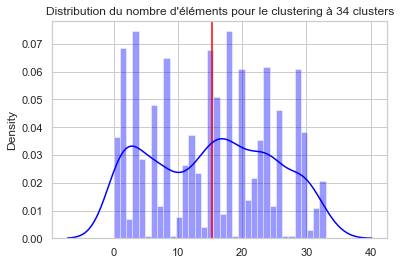

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


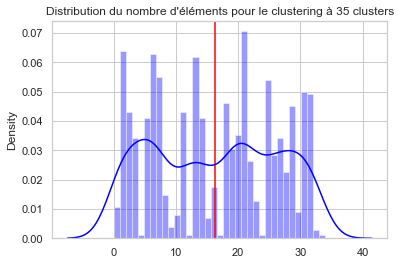

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


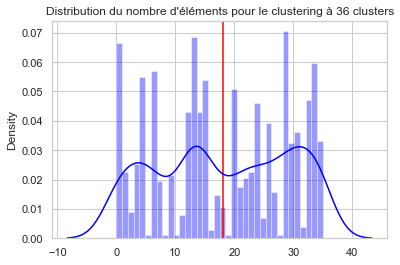

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


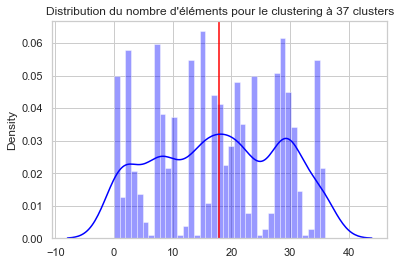

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


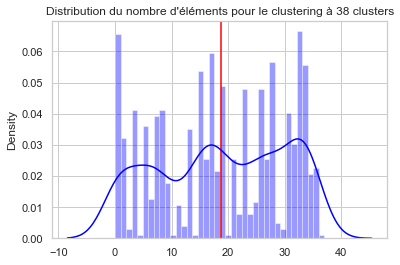

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


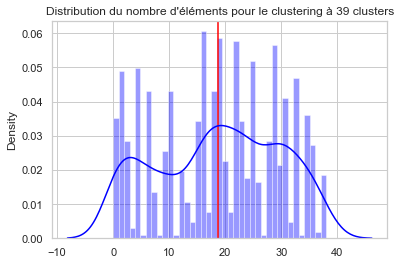

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


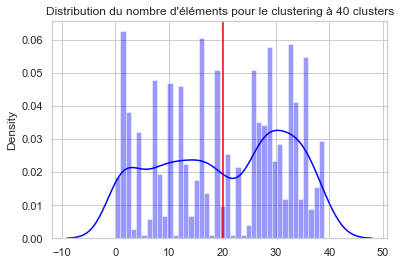

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


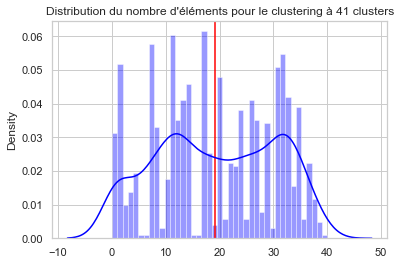

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


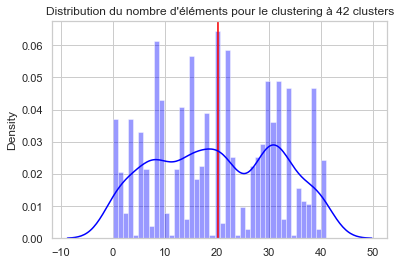

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


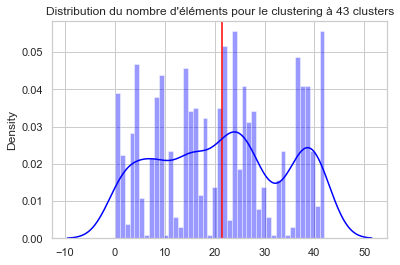

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


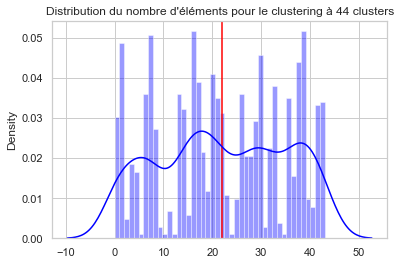

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


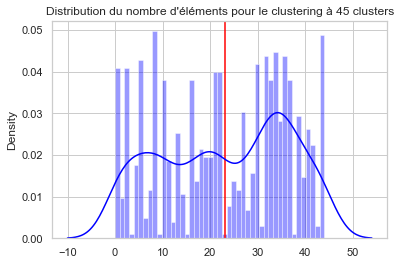

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


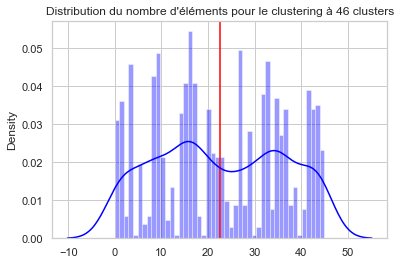

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


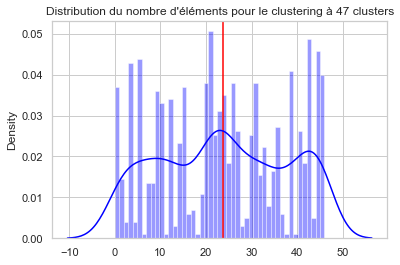

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


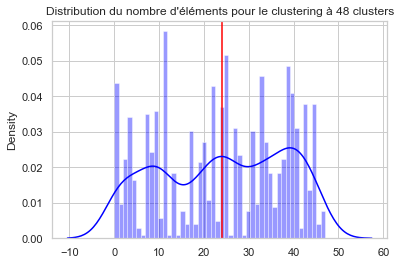

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


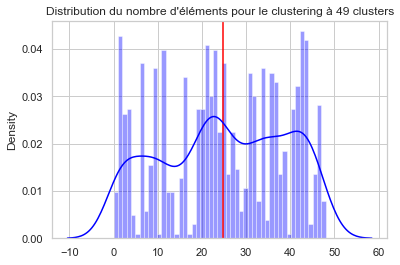

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


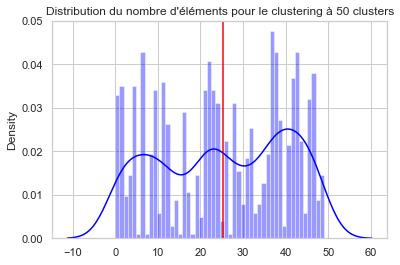

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


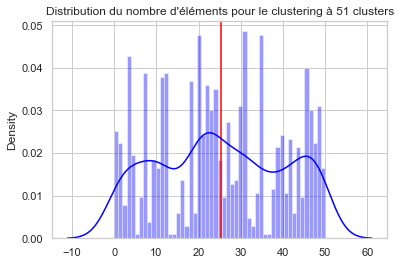

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


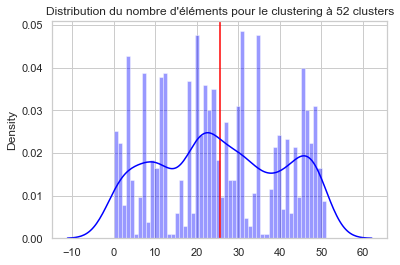

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


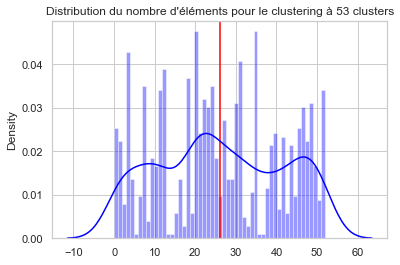

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


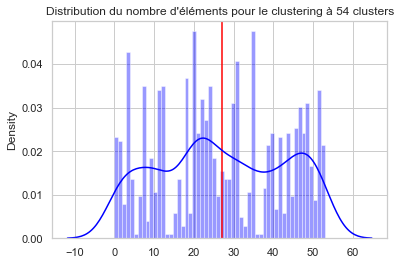

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


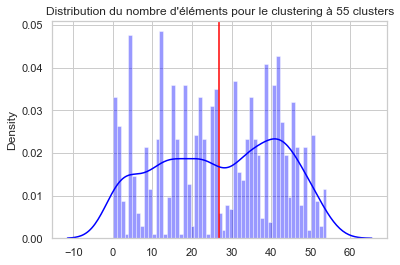

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


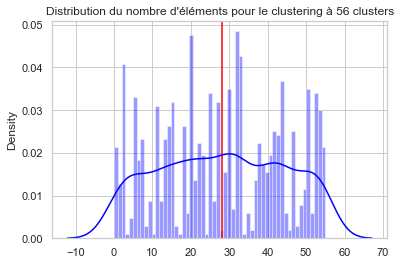

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


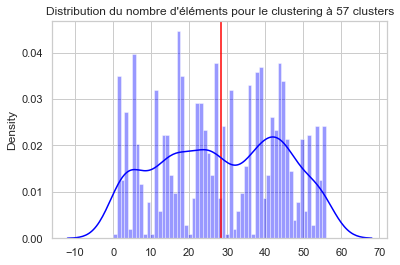

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


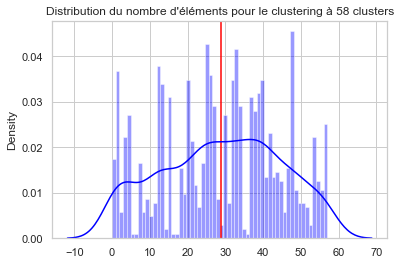

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


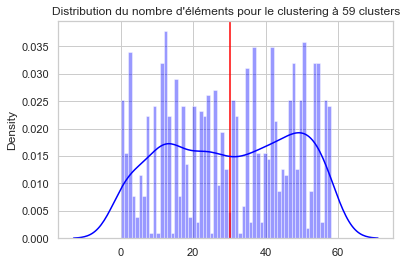

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


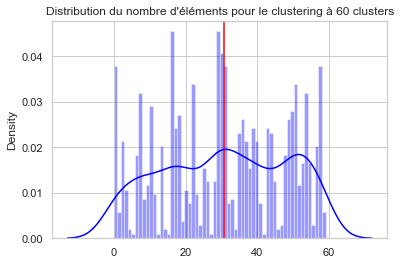

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


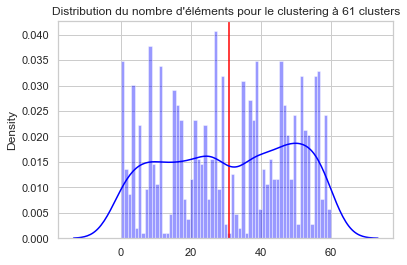

C:\Users\Win\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


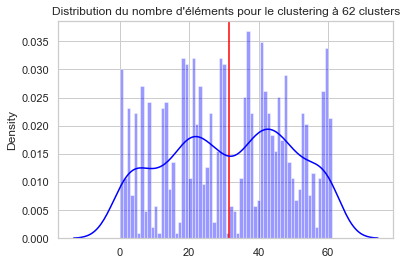

In [276]:
for i in range(2,max_clusters):
    plt.figure()
    titre = "Distribution du nombre d'éléments pour le clustering à " + str(i) + ' clusters'
    plt.title(titre)
    mean = dict_kmeans_[i].labels_.mean()
    plt.axvline(mean, 0, 1, color='red')
    sns.distplot(dict_kmeans_[i].labels_, bins = i, color='blue'  )
    plt.show()

In [286]:
jeu_categoriel = pd.DataFrame(X_NLP)
jeu_categoriel['label'] = dict_kmeans_[10].labels_

In [287]:
jeu_categoriel.to_csv('D:/Projet Classrooms/Projet_6/data_saved_jeu_complet_kmeans.csv')

In [288]:
jeu_categoriel.shape

(1050, 548)

## Visualisation T-SNE

C:\Users\Win\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\Win\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


<AxesSubplot:title={'center':'Représentation du jeu de données via T-SNE'}>

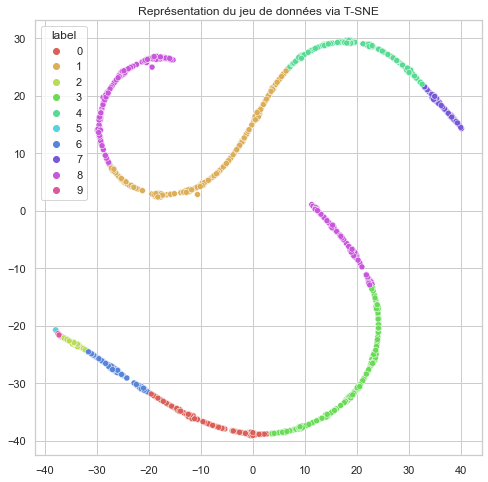

In [289]:
tsne = manifold.TSNE(n_components = 2)
T = tsne.fit_transform(X_combined.copy())
plt.figure(figsize = (8,8))
plt.title('Représentation du jeu de données via T-SNE')
palette_sns = sns.color_palette("hls", jeu_categoriel['label'].nunique())
sns.scatterplot(x= T[:,0], y = T[:,1], hue = jeu_categoriel['label'], palette = palette_sns)